# Dust Buildup at High-z 

This notebook includes all of the functions, plots, and analysis needed to produce any data products or plots for the "Dust Build-up at High-z" paper using my personal analysis scripts.

Always runs the first few cells before running code in any section!

In [3]:
%load_ext autoreload
%autoreload 2

import os
import sys
import numpy as np
np.set_printoptions(threshold=sys.maxsize)

from crc_scripts.io.gizmo import *
from crc_scripts.observations import dust_obs as obs
from crc_scripts.observations.obs_data import Observational_Data
from crc_scripts.plot_functions import *
from crc_scripts.utils.math_utils import *
from crc_scripts.figure import Figure,Projection
from crc_scripts.analysis.data_reduction import Buffer

# First setup directory for all the plots
plot_dir = './HighZ_dust/'
os.makedirs(plot_dir, exist_ok=True)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Simulation Info 
Definitions for simulation info which is used by all routines

In [10]:
# Main directory
main_dirc = '/N/scratch/cchoban/HiZ_dust/'
# Names of simulation directories
names = np.array(['z5m11d','z5m12a','z5m12b','z5m12d',
                  'z7m12a','z7m12b','z7m12c','z9m12a',
                  'z5m12a_4acc','z5m12a_0.9sd',
                  'z5m11d_0.2sd_4acc','z5m12a_0.2sd_4acc','z5m12b_0.2sd_4acc','z5m12d_0.2sd_4acc',
                  'z7m12a_0.2sd_4acc','z7m12b_0.2sd_4acc','z7m12c_0.2sd_4acc','z9m12a_0.2sd_4acc',
                  'z5m12a_0.2sd_4acc_Tcut','z5m12a_0.2sd_4acc_FIRE3'])

short_names = np.array(['z5m11d','z5m12a','z5m12b','z5m12d',
                  'z7m12a','z7m12b','z7m12c','z9m12a',
                  'z5m12a_4acc','z5m12a_0.9sd',
                  'z5m11d_enh','z5m12a_enh','z5m12b_enh','z5m12d_enh',
                  'z7m12a_enh','z7m12b_enh','z7m12c_enh','z9m12a_enh',
                  'z5m12a_enh_Tcut','z5m12a_enh_FIRE3'])


# Some masks to get subsets of the simulations
all_mask = np.arange(len(names))
fiducial_mask = np.char.find(names, "_") < 0
z5m12a_mask = np.char.find(names, "z5m12a") >= 0
z5m12d_mask = np.char.find(names, "z5m12d") >= 0
z5m12b_mask = np.char.find(names, "z5m12b") >= 0
z5enh_mask = (np.char.find(names, "z5") >= 0) & (np.char.find(names, "0.2sd_4acc") >= 0) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))
z7enh_mask = (np.char.find(names, "z7") >= 0) & (np.char.find(names, "0.2sd_4acc") >= 0) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))
z9enh_mask = (np.char.find(names, "z9") >= 0) & (np.char.find(names, "0.2sd_4acc") >= 0) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))
z79enh_mask = ((np.char.find(names, "z9") >= 0) | (np.char.find(names, "z7") >= 0)) & (np.char.find(names, "0.2sd_4acc") >= 0) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))

z5fid_mask = (np.char.find(names, "z5") >= 0) & (np.char.find(names, "_") < 0)
z7fid_mask = (np.char.find(names, "z7") >= 0) & (np.char.find(names, "_") < 0)
z9fid_mask = (np.char.find(names, "z9") >= 0) & (np.char.find(names, "_") < 0)
z79fid_mask = ((np.char.find(names, "z9") >= 0) | (np.char.find(names, "z7") >= 0)) & (np.char.find(names, "_") < 0)

z5m12b_z7m12c_mask = ((np.char.find(names, "z5m12b") >= 0) | (np.char.find(names, "z7m12c") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))

z5m11d_z5m12d_mask = ((np.char.find(names, "z5m11d") >= 0) | (np.char.find(names, "z5m12d") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))
z5m12a_z7m12b_mask = ((np.char.find(names, "z5m12a") >= 0) | (np.char.find(names, "z7m12b") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0)) & ~((np.char.find(names, "z5m12a_4acc") >= 0)) & ~((np.char.find(names, "z5m12a_0.9sd") >= 0))
z7m12a_z9m12a_mask = ((np.char.find(names, "z7m12a") >= 0) | (np.char.find(names, "z9m12a") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))

FIRE3_mask = np.char.find(names, "FIRE3") >= 0
enhanced_mask = (np.char.find(names, "0.2sd_4acc") >= 0) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))

fid_and_enh_mask = (np.char.find(names, "_") < 0) | ((np.char.find(names, "0.2sd_4acc") >= 0) & ~(np.char.find(names, "0.2sd_4acc_") >= 0))


FIRE_ver = [2]*(len(names)-1)+[3]


# Main sim directories and their snap and halo directories
# Note you need to specify the dtype or else you get numpy strings which annoying to deal with
main_dirs = np.array([main_dirc+name+'/' for name in names], dtype=object)
snap_dirs = np.array([main_dirc+name+'/output/' for name in names], dtype=object)
hdirs = np.array([main_dirc+name+'/halo/ahf/output/' for name in names], dtype=object)
# We only look at the main halos
halo_histories = np.array([main_dirc+name+'/halo/ahf/history/halo_main.dat' for name in names], dtype=object)

# Final snapshot number since sims are run to varying redshift
final_snaps = np.zeros(len(names),dtype=int)
for i,snap_dir in enumerate(snap_dirs):
    snap_files = os.listdir(snap_dir)
    snap_nums = []
    for snap_file in snap_files:
        if 'snapshot' in snap_file:
            if snap_file[9:12] == '000':
                snap_nums += [0]
            else:
                snap_nums += [int(snap_file[9:12].lstrip('0'))]
    final_snaps[i]=np.max(snap_nums)

# Nothing interesting in earlier snaps so limit first snapshot to 10
first_snaps = [10]*len(names)
# FIRE-3 has different snapshot numbering so this roughly corresponds to the same redshift as FIRE-2
first_snaps[-1]=8


[67 67 66 67 32 35 41 16 67 67 67 67 64 67 33 33 41 18 67]


## Galactic Properties

Load in each simulation and calculate general galactic properties for simulation table.

In [14]:
# Select what subset of the sims you want
mask = z5m12a_mask

indices = np.arange(len(names))[mask]
for i in indices:
    snap_dir=snap_dirs[i]
    hdir = hdirs[i];name = names[i];snap_num = final_snaps[i]
    halo = load_halo(snap_dir, snap_num, cosmological=1, id=-1, mode='AHF', hdir=hdir)
    print(name)

    halfmass_radius = halo.get_half_mass_radius(within_radius=None, geometry='spherical', ptype=4, rvir_frac=1)

    #halo.set_zoom(rout=3*halfmass_radius, kpc=True)
    halo.set_zoom(rout=1.0, kpc=False)
    gas = halo.loadpart(0)
    star = halo.loadpart(4)

    print("\t Final Redshift:",halo.redshift)
    print("\t M_vir:",halo.mvir/1E10, "10^10 M_sol")
    print("\t R_vir:",halo.rvir, "kpc")

    if len(gas.h) > 0:
        print("\t softening min:",np.min(gas.h))
    else:
        print("\t No gas within 3 x half mass radius!")
    M_star = np.sum(star.get_property('M'))
    print("\t M_stellar:",M_star/1E10,"10^10 M_Solar")
    print("\t R_1/2:",halfmass_radius, "kpc")
    M_gas = np.sum(gas.get_property('M'))
    print("\t M_gas:",M_gas/1E10,"10^10 M_Solar")
    M_metal = np.sum(gas.get_property('M_metals'))
    print("\t M_metal:",M_metal/1E10,"10^10 M_Solar")
    M_dust = np.sum(gas.get_property('M_dust'))
    print("\t M_dust:",M_dust/1E10,"10^10 M_Solar")
    print("\t Median Z:",np.median(gas.get_property('Z')),"Z_solar")
    print("\t Median D/Z:",np.median(gas.get_property('D/Z')))
    age = star.get_property('age')
    sfr_10Myr = np.sum(star.get_property('M')[age<0.01])/1E7
    print("\t SFR_10Myr:",sfr_10Myr,"M_Solar/yr")
    sfr_100Myr = np.sum(star.get_property('M')[age<0.1])/1E8
    print("\t SFR_100Myr:",sfr_100Myr,"M_Solar/yr")
    # Now the latex table line
    print(r'%s & %1.2f & %1.2E & %1.2f & %1.2E & %1.2f & %1.2E & %1.2E & %1.2E & %1.2f & \\'%(name,halo.redshift,halo.mvir,halo.rvir,M_star,halfmass_radius,M_gas,M_metal,M_dust,sfr_10Myr))
    del halo

Looking for snapshot's corresponding AHF file
z5m12a
Ptype 4 half mass radius: 6.228000e+00 kpc


KeyboardInterrupt: 

## Simulation End Plots

Load in just the simulations you want to avoid memory issues

In [27]:
prefix_name = 'enhanced'
mask = names=='z5m12a_0.2sd_4acc'


snap_objs=[]
snap_names = []

labels = names[mask]

for i, snap_dir in enumerate(snap_dirs[mask]):
    hdir = hdirs[mask][i];name = names[mask][i];snap_num = final_snaps[mask][i]
    halo = load_halo(snap_dir, snap_num, cosmological=1, id=-1, mode='AHF', hdir=hdir)
    print(name)

    snap=load_snap(snap_dir, snap_num, cosmological=1)
    star = snap.loadpart(4)
    print(np.mean(star.p,axis=0))
    print(halo.center_position)
    halo.assign_center()
    halo.set_zoom(rout=1.0, kpc=False)

    snap_objs+=[halo]
    snap_names += [name]

snap_objs=np.array(snap_objs)

Looking for snapshot's corresponding AHF file
z5m12a_0.2sd_4acc
[3386.91862742 3533.42634059 3541.0864078 ]
[3386.7119656552914, 3534.315624360203, 3544.885142432732]
assigning center of galaxy:
  center position [kpc] = 3386.729, 3534.346, 3544.908
  center velocity [km/s] = -41.5, -33.7, -110.9


### Phase Histograms

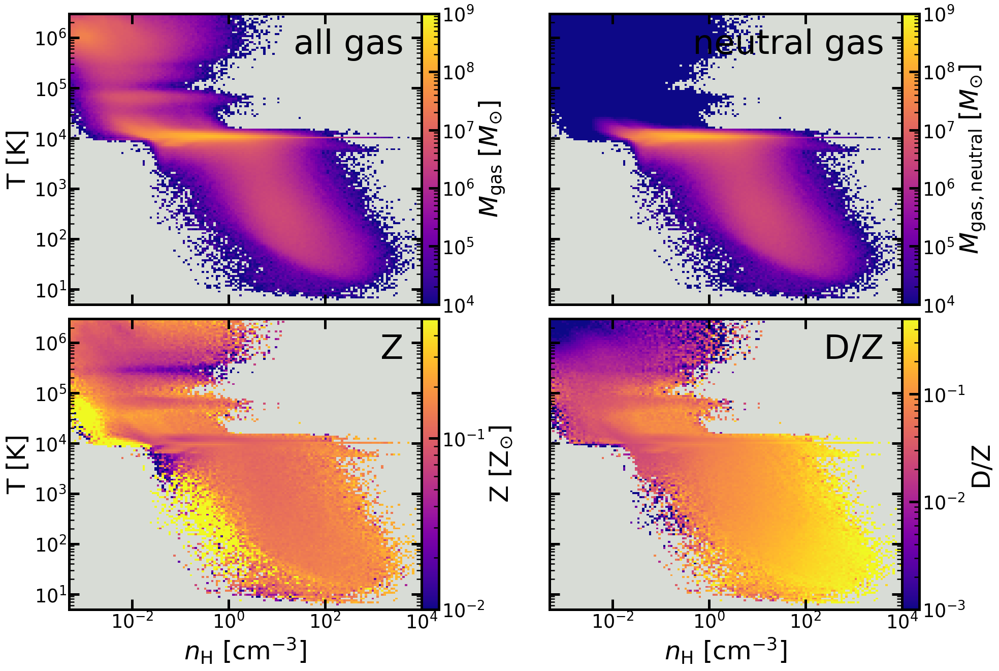

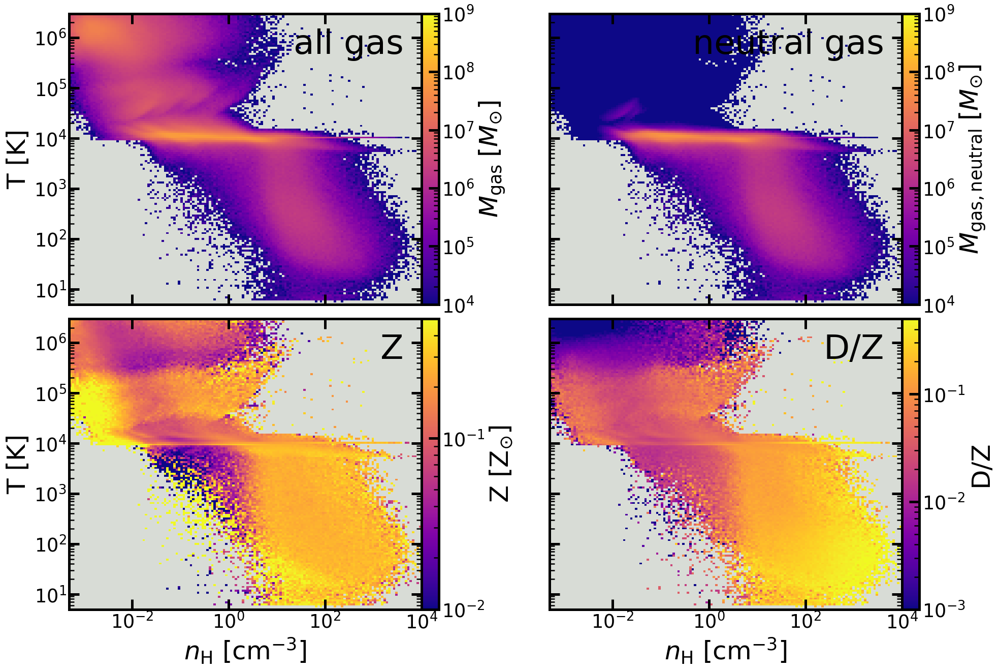

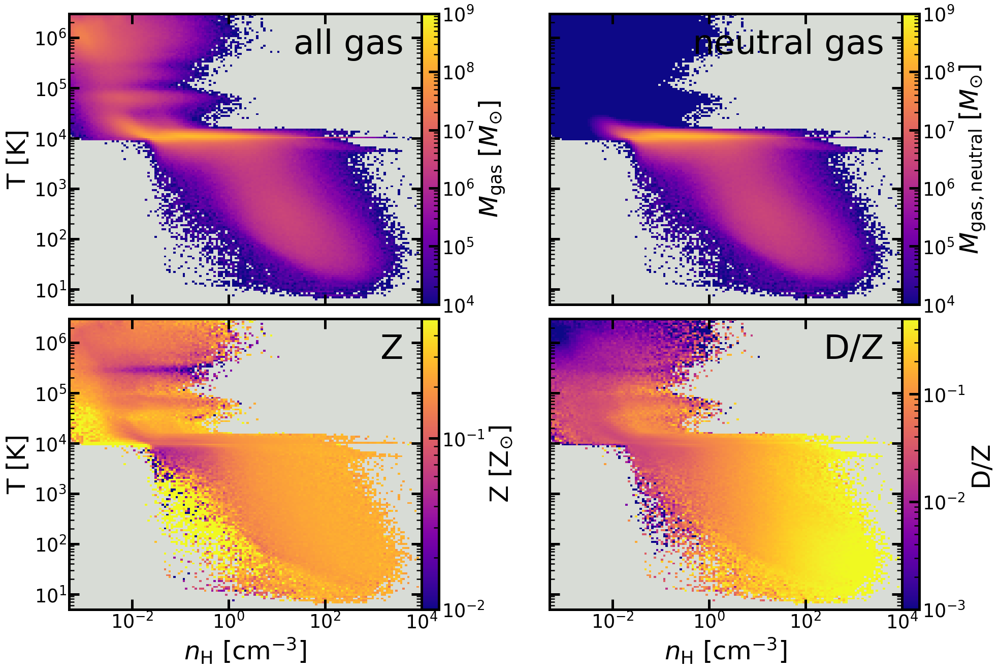

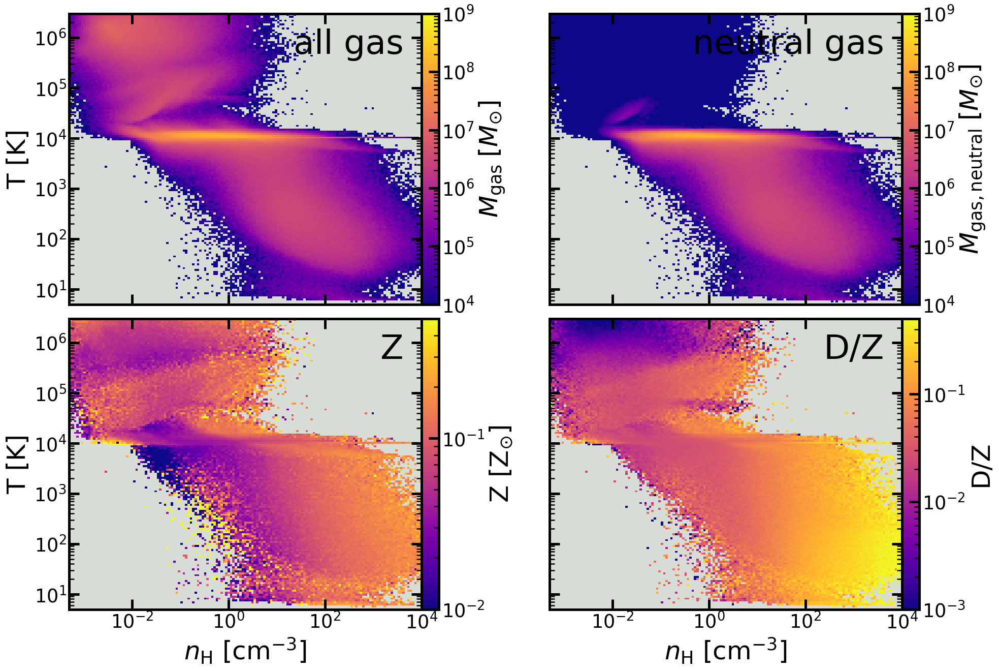

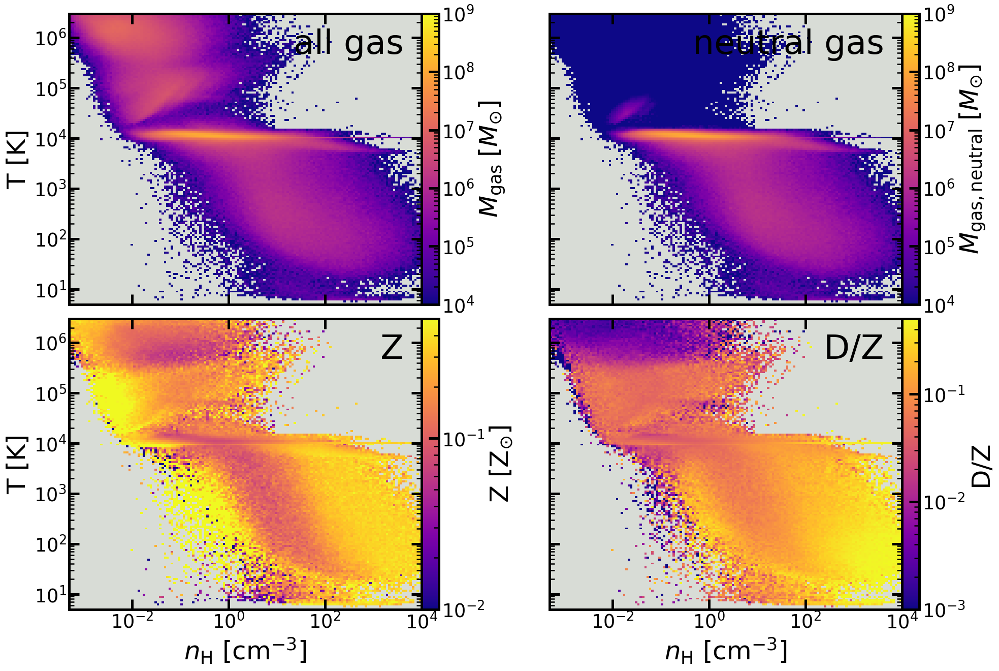

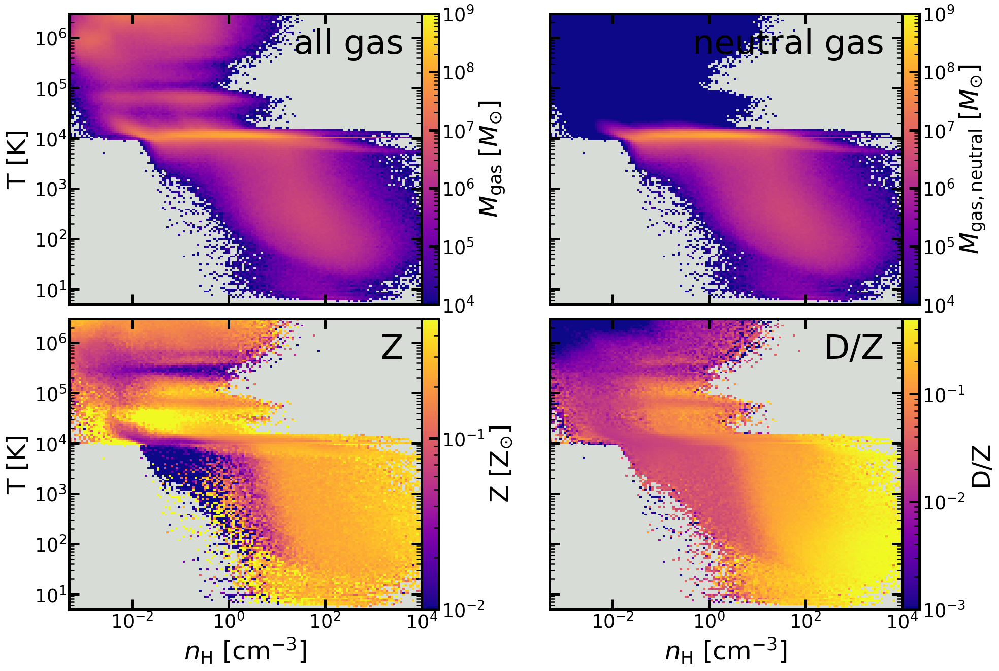

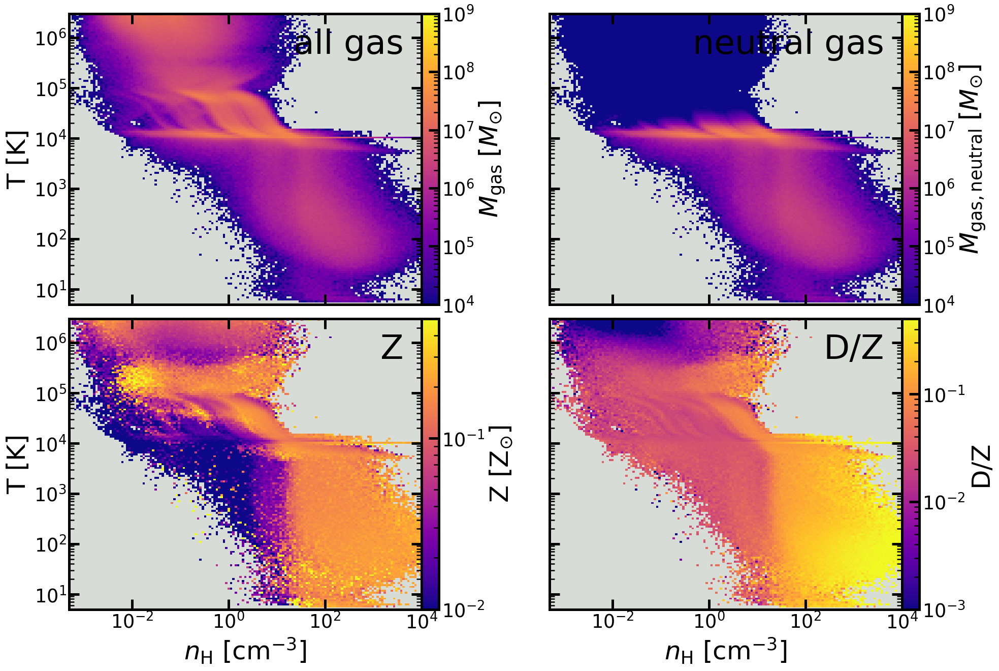

In [71]:
foutname='metals&dust_gas_phase.png'
# Property to bin in phase diagram
props = ['M_gas','M_gas_neutral','Z','D/Z']
fig_labels = ['all gas','neutral gas','Z','D/Z']
z_logs=[True]*len(props)
# Number of bins across nH and T space
bin_nums = 150
cmap='plasma'
# nH and T limits
nH_lims = [5E-4,1E4]
T_lims = [5,3E6]

prop_lims=[[1E4,1E9],[1E4,1E9],[0.01,0.5],[0.001,0.5]]

for i, snap in enumerate(snap_objs):
    name = snap_names[i]
    # Setup figure
    fig = Figure(len(props),ncols=2, sharex='col',sharey='row')

    for j,prop in enumerate(props):
        # Set up for each plot
        fig.set_axis(j, 'nH', 'T', x_lim=nH_lims, x_log=True, y_lim=T_lims, y_log=True, face_color='xkcd:light grey')
        ret = calc.calc_phase_hist_data(prop, snap, bin_nums=bin_nums, nH_lims=nH_lims, T_lims=T_lims)
        X, Y = np.meshgrid(ret.x_edge, ret.y_edge)
        fig.plot_histogram(j, prop, X, Y, ret.statistic.T, cmap=cmap, z_lim=prop_lims[j], z_log=z_logs[j],label=fig_labels[j])

        # Add colorbar to last axis
        fig.add_colorbar(j,cbar_prop=prop)

    fig.save(plot_dir+name+'_'+foutname)

### Projections 

Projection size: 19.566 kpc


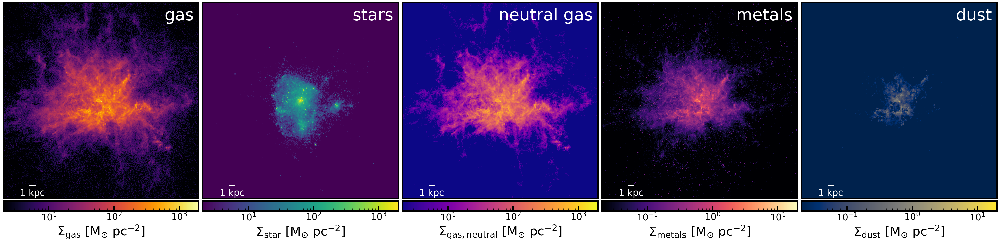

In [28]:
# Properties to plot projections of. Can be surface densities (total mass in pixel divied by pixel size) or properties like T (median value of all particles in pixel)
properties = ['sigma_gas','sigma_star','sigma_gas_neutral','sigma_metals','sigma_dust']
# Limits for projection of each property. Defaults if not set
prop_limits = [[2E0,2E3],[2E0,2E3],[2E0,2E3],[2E-2,2E1],[2E-2,2E1]]
# Colormaps for each projection
prop_cmaps = ['inferno','viridis','plasma','magma','cividis']
# Do you want log colormaps (default = yes)
log_cmap = [True]*len(properties)
# Labels for each projection is so desired
labels = ['gas','stars','neutral gas','metals','dust']
# Physical size of projection
rvir_frac = 0.5 # rvir_frac
# Do you want a secondary projection from an orthogonal axis?
sub_proj = False
# size of secondary projection
sub_L = 2 # kpc
# Do you want colorbars for each projection?
has_colorbars=True
# Size resolution (kpc) for each "pixel" in projection
pixel_res=0.05

# Saved image name
foutname='snap_projection.png'

print(snap_objs)
for i,snap in enumerate(snap_objs):
    # Initialize projection figure
    L = rvir_frac*snap.rvir
    height_ratios = [L/sub_L,1]
    new_proj = Projection(len(properties), sub_proj=sub_proj, has_colorbars=has_colorbars, height_ratios=height_ratios)
    # Create projections for each property and plot the projection
    print('Projection size: %.3f kpc'%L)
    for j,prop in enumerate(properties):
        new_proj.set_axis(j, prop, L, axes_visible=False)
        # x-y projection
        main_pixel_stats, main_xedges, main_yedges, main_extent = calc.calc_projected_prop(prop, snap, [L,L,L], pixel_res=pixel_res, proj='xy')
        # x-z projection
        #sub_pixel_stats, sub_xedges, sub_yedges, sub_extent = calc.calc_projected_prop(prop, snap, [L,sub_L,L], pixel_res=pixel_res, proj='xz')
        new_proj.plot_projection(j, main_pixel_stats, main_extent, sub_proj_data=None, sub_extent=None,
                                 cmap= prop_cmaps[j], v_limits = prop_limits[j],v_log=log_cmap[j], label=labels[j])

    new_proj.save(plot_dir+snap_names[i]+'_'+foutname)

In [11]:
# Properties to plot projections of. Can be surface densities (total mass in pixel divied by pixel size) or properties like T (median value of all particles in pixel)
properties = ['sigma_gas','sigma_star','sigma_gas_neutral','sigma_metals','sigma_dust']
# Limits for projection of each property. Defaults if not set
prop_limits = [[2E0,2E3],[2E0,2E3],[2E0,2E3],[2E-2,2E1],[2E-2,2E1]]
# Colormaps for each projection
prop_cmaps = ['inferno','viridis','plasma','magma','cividis']
# Do you want log colormaps (default = yes)
log_cmap = [True]*len(properties)
# Labels for each projection is so desired
labels = ['gas','stars','neutral gas','metals','dust']
# Physical size of projection
rvir_frac = 0.5 # rvir_frac
# Do you want a secondary projection from an orthogonal axis?
sub_proj = False
# size of secondary projection
sub_L = 2 # kpc
# Do you want colorbars for each projection?
has_colorbars=True
# Size resolution (kpc) for each "pixel" in projection
pixel_res=0.05

# Saved image name
foutname='snap_projection.png'


for i,snap in enumerate(snap_objs):
    # Initialize projection figure
    L = rvir_frac*snap.rvir
    height_ratios = [L/sub_L,1]
    new_proj = Projection(len(properties), sub_proj=sub_proj, has_colorbars=has_colorbars, height_ratios=height_ratios)
    # Create projections for each property and plot the projection
    print('Projection size: %.3f kpc'%L)
    for j,prop in enumerate(properties):
        new_proj.set_axis(j, prop, L, axes_visible=False)
        # x-y projection
        main_pixel_stats, main_xedges, main_yedges, main_extent = calc.calc_projected_prop(prop, snap, [L,L,L], pixel_res=pixel_res, proj='xy')
        # x-z projection
        #sub_pixel_stats, sub_xedges, sub_yedges, sub_extent = calc.calc_projected_prop(prop, snap, [L,sub_L,L], pixel_res=pixel_res, proj='xz')
        new_proj.plot_projection(j, main_pixel_stats, main_extent, sub_proj_data=None, sub_extent=None,
                                 cmap= prop_cmaps[j], v_limits = prop_limits[j],v_log=log_cmap[j], label=labels[j])

    new_proj.save(plot_dir+snap_names[i]+'_'+foutname)

## Time Evolution

Process snapshots for time evolution data and make time evolution plots.

### Process Time Evolution Data (THIS TAKES TIME AND USES A LOT OF MEMORY)

In [32]:
# Maximum radius (fraction of Rvir) to get data)
# Papers choose 0.2 Rvir since stellar populations are usually more extended at high redshift
rvir_frac = 0.2 # times Rvir

sims=[]
for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    first_snap = first_snaps[i]
    snap_nums = list(range(first_snap,final_snaps[i]+1))
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)

    sims+=[buff]
sims=np.array(sims)

Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing 

### Evolution of galactic properties for all galaxies

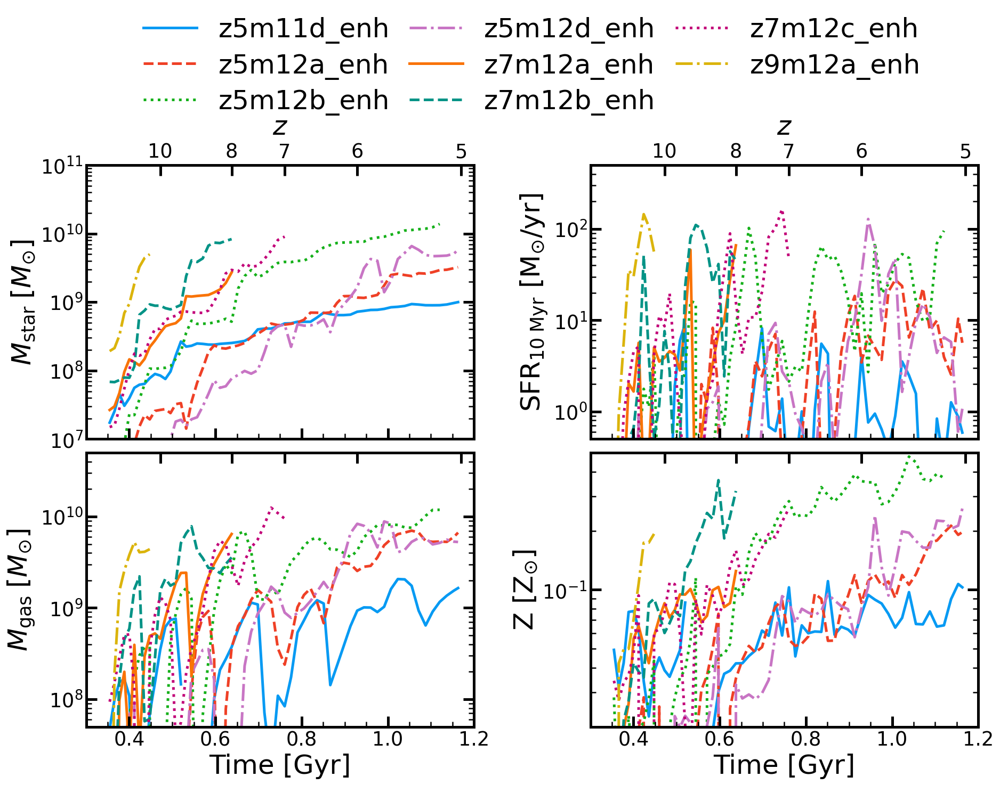

In [39]:
mask=enhanced_mask
prefix = 'enhanced'

foutname = prefix+'_'+str(rvir_frac)+'Rvir_reduced_galaxy_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_star','sfr_10Myr','M_gas','Z']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[1E7,1E11],[5E-1,5E2],[5E7,5E10],[2E-2,0.5],]
x_lim=[0.3,1.2]
y_logs=[True]*len(params); #y_logs[3]=False

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
#labels = names[mask]
labels = short_names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
gas_sample = 'all'
star_sample='all'
metal_sample = 'cold'
subsample = [star_sample,star_sample,gas_sample,metal_sample,gas_sample,gas_sample,star_sample]
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex=True, orientation='vertical',ncols=2,yx_ratio=0.9)

for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=3)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


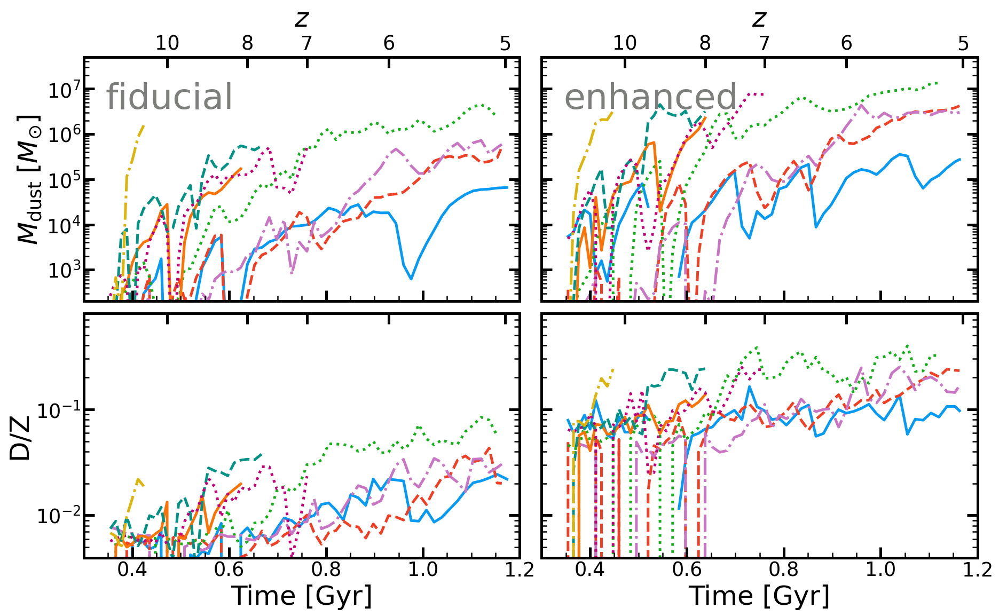

In [63]:
mask= fid_and_enh_mask
prefix = 'fid_and_enh'

foutname = prefix+'_'+str(rvir_frac)+'Rvir_Mdust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_dust','D/Z']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[2E2,5E7],[2E-3,8E-1]]
x_lim=[0.3,1.20]
y_logs=[True]*len(params);

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
#labels = names[mask]
labels = short_names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsample = ['all','cold']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
half_len = len(data_objs)//2
linewidths, colors, linestyles = plt_set.setup_plot_style(half_len, style=style)
colors=colors*2
linestyles=linestyles*2
linewidths*=2
# Lets just make the enhanced subsample large
#linewidths=[0.75*config.BASE_LINEWIDTH]*half_len + [1.5*config.BASE_LINEWIDTH]*half_len
# Setup figure
fig = Figure(2*len(params), sharex='col', sharey='row', orientation='horizontal',ncols=2, yx_ratio=0.8)

for i, y_prop in enumerate(params):
    fig.set_axis(i*2, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
    fig.set_axis(i*2+1, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
    if i==0:
        fig.add_text(i*2, .05, .9, 'fiducial', color='xkcd:medium grey', fontsize=config.EXTRA_LARGE_FONT, ha='left',
                    va='top', zorder=1)
        fig.add_text(i*2+1, .05, .9, 'enhanced', color='xkcd:medium grey', fontsize=config.EXTRA_LARGE_FONT, ha='left',
                    va='top', zorder=1)
    sample = subsample[i]

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)
        

        data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
        plot_num = i*2+j//half_len
        fig.plot_line_data(plot_num, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                  linewidth=linewidths[j], zorder=-1)


fig.save(plot_dir+foutname)


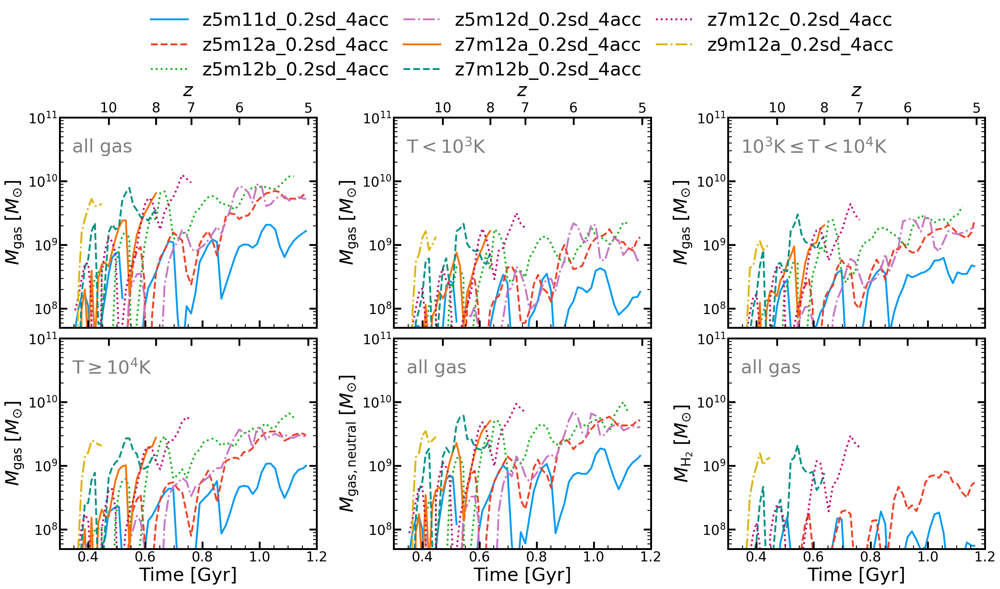

In [229]:
mask=enhanced_mask
prefix = 'enhanced'

foutname = prefix+'_all_galaxy_ISM_phases_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_gas','M_gas','M_gas','M_gas','M_gas_neutral','M_H2']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E7,1E11]]*len(params)
x_lim=[0.3,1.2]
y_logs=[True]*(len(params))

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
# Labels you to give to the data objects
labels = names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'total'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsample = ['all','cold','warm','hot','all','all']
subsample_labels = ['all gas',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K','all gas','all gas']

# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex='col', orientation='vertical')
for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    fig.add_text(i, .05, .9, subsample_labels[i], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                va='top', zorder=1)

    for j, data in enumerate(data_objs):

        label = labels[j]
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=3)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


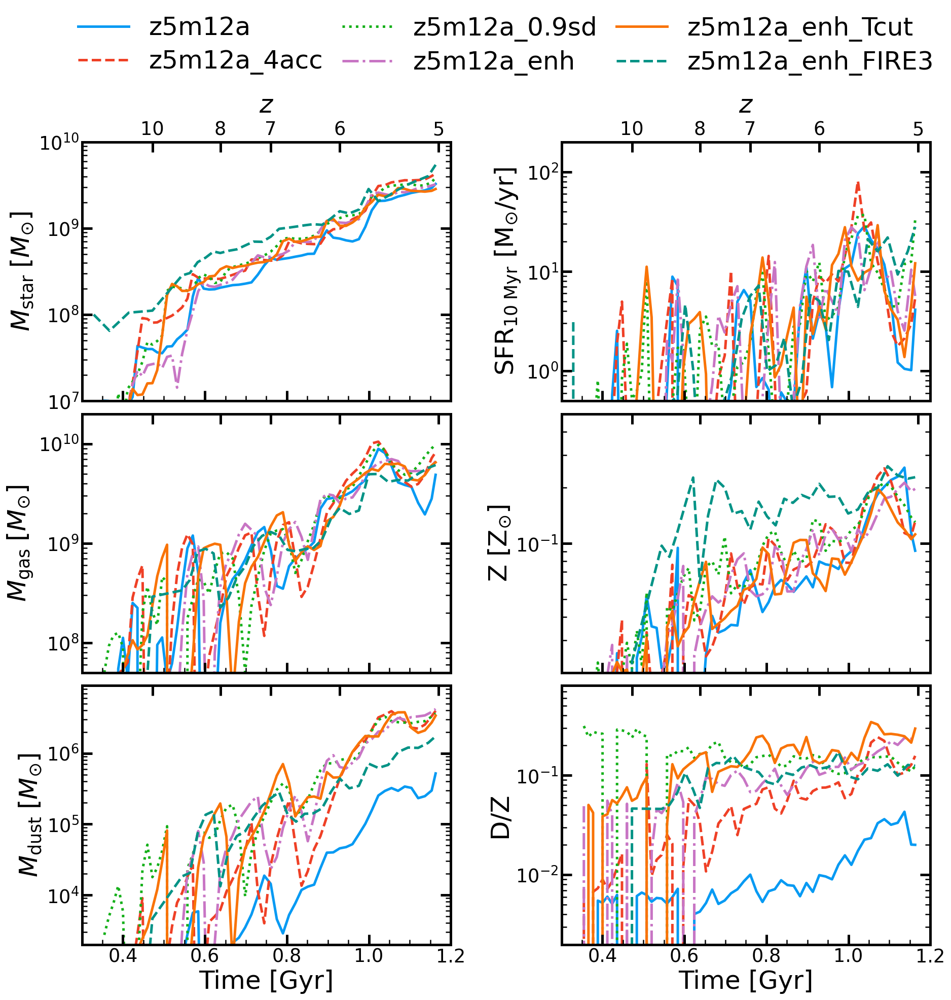

In [231]:
mask=z5m12a_mask
prefix = 'appendix_z5m12a_comparisons'

foutname = prefix+'_'+str(rvir_frac)+'Rvir_reduced_galaxy_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_star','sfr_10Myr','M_gas','Z','M_dust','D/Z']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[1E7,1E10],[5E-1,2E2],[5E7,2E10],[2E-2,0.5],[2E3,9E6],[2E-3,8E-1]]
x_lim=[0.3,1.2]
y_logs=[True]*len(params); #y_logs[3]=False

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
#labels = names[mask]
labels = short_names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
gas_sample = 'all'
star_sample='all'
metal_sample = 'cold'
subsample = [star_sample,star_sample,gas_sample,metal_sample,gas_sample,metal_sample]
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex=True, orientation='vertical',ncols=2,yx_ratio=0.9)

for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=3)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


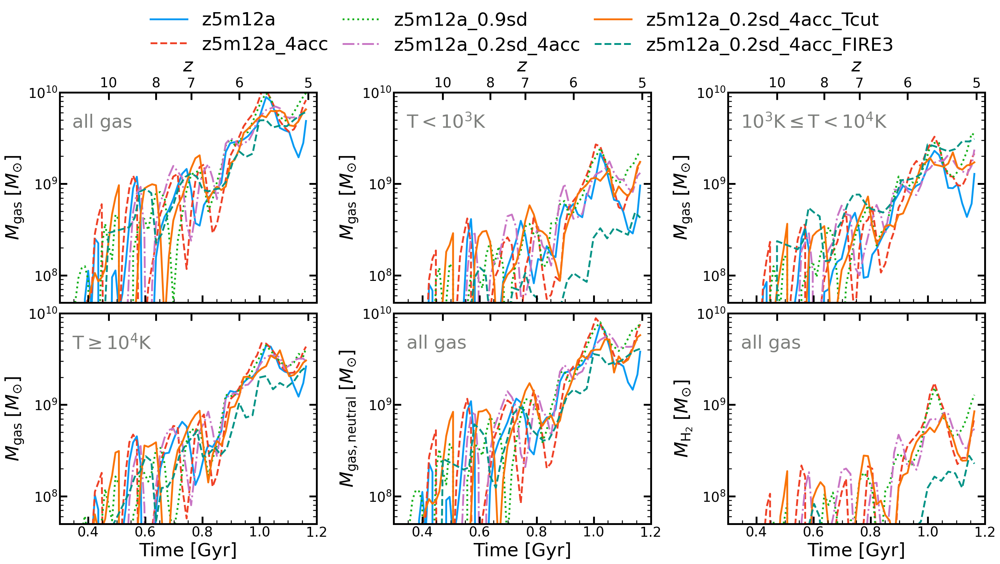

In [230]:
mask=z5m12a_mask
prefix = 'z5m12a_comparisons'

foutname = prefix+'_ISM_phases_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_gas','M_gas','M_gas','M_gas','M_gas_neutral','M_H2']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E7,1E10]]*len(params)
x_lim=[0.3,1.2]
y_logs=[True]*(len(params))

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
# Labels you to give to the data objects
labels = names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'total'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsample = ['all','cold','warm','hot','all','all']
subsample_labels = ['all gas',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K','all gas','all gas']

# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex='col', orientation='vertical')
for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    fig.add_text(i, .05, .9, subsample_labels[i], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                va='top', zorder=1)

    for j, data in enumerate(data_objs):

        label = labels[j]
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=3)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


### Evolution of metals and dust populations for each galaxy

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


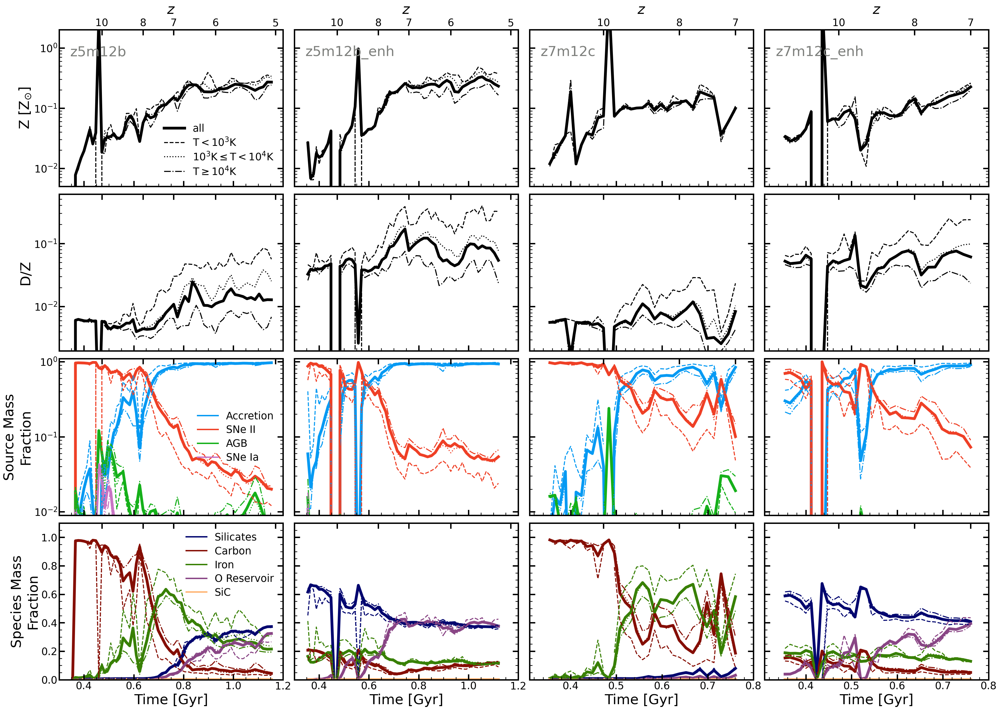

In [64]:
mask = z5m12b_z7m12c_mask
prefix='select_comparison'

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-3,2E0],[2E-3,6E-1],[9E-3,1.1],[0,1.1]]
x_lims=[[0.3,1.2],[0.31,0.8]]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask][[0,2,1,3]]
sim_labels = short_names[mask][[0,2,1,3]]

# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lims[j//2], y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        for k,sample in enumerate(subsamples):
            # Check if parameter has subparameters
            if len(param_labels) == 0:
                data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
                fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                          linewidth=linewidths[k], zorder=-1)
            else:
                data_vals = []
                for sub_param in sub_y_props:
                    data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                data_vals = np.array(data_vals)
                for m in range(np.shape(data_vals)[0]):
                    # Ignore properties that are zero for the entire simulation and don't plot them
                    if not np.all(data_vals[m, :] == 0):
                        fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                  linewidth=linewidths[k], zorder=-1, label=param_labels[m])

            # Only need to label the subsamples in the first plot
            if axis_num == 0 and len(subsamples) > 1:
                fig.set_axis_legend(axis_num,ncol=1,loc='best')

            # If there are subparameters need to make their own legend but only for the first sim
            if len(param_labels) > 0 and j == 0:
                # param_labels = param_labels[:np.shape(data_vals)[1]]
                param_lines = []
                for k, label in enumerate(param_labels):
                    param_lines += [
                        mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=config.BASE_LINEWIDTH)]
                fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1)

fig.save(plot_dir+foutname)

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


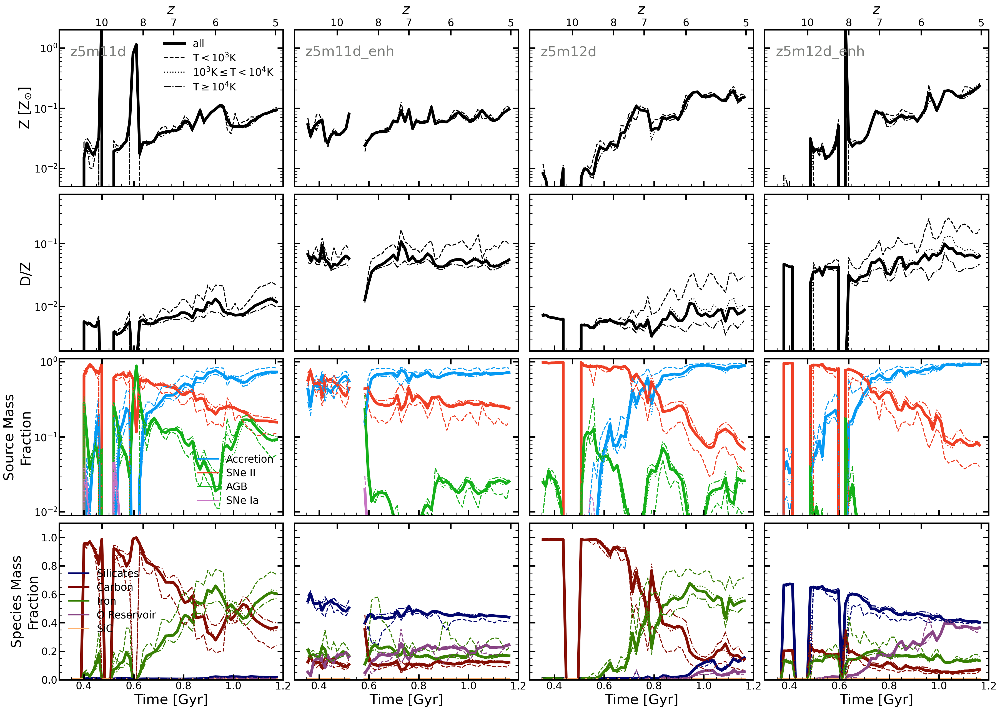

In [256]:
mask = z5m11d_z5m12d_mask
prefix='appendix_comparison1'

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-3,2E0],[2E-3,6E-1],[9E-3,1.1],[0,1.1]]
x_lims=[[0.3,1.2],[0.3,1.2]]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask][[0,2,1,3]]
sim_labels = short_names[mask][[0,2,1,3]]

# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lims[j//2], y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        for k,sample in enumerate(subsamples):
            # Check if parameter has subparameters
            if len(param_labels) == 0:
                data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
                fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                          linewidth=linewidths[k], zorder=-1)
            else:
                data_vals = []
                for sub_param in sub_y_props:
                    data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                data_vals = np.array(data_vals)
                for m in range(np.shape(data_vals)[0]):
                    # Ignore properties that are zero for the entire simulation and don't plot them
                    if not np.all(data_vals[m, :] == 0):
                        fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                  linewidth=linewidths[k], zorder=-1, label=param_labels[m])

            # Only need to label the subsamples in the first plot
            if axis_num == 0 and len(subsamples) > 1:
                fig.set_axis_legend(axis_num,ncol=1,loc='best')

            # If there are subparameters need to make their own legend but only for the first sim
            if len(param_labels) > 0 and j == 0:
                # param_labels = param_labels[:np.shape(data_vals)[1]]
                param_lines = []
                for k, label in enumerate(param_labels):
                    param_lines += [
                        mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=config.BASE_LINEWIDTH)]
                fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1)

fig.save(plot_dir+foutname)

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


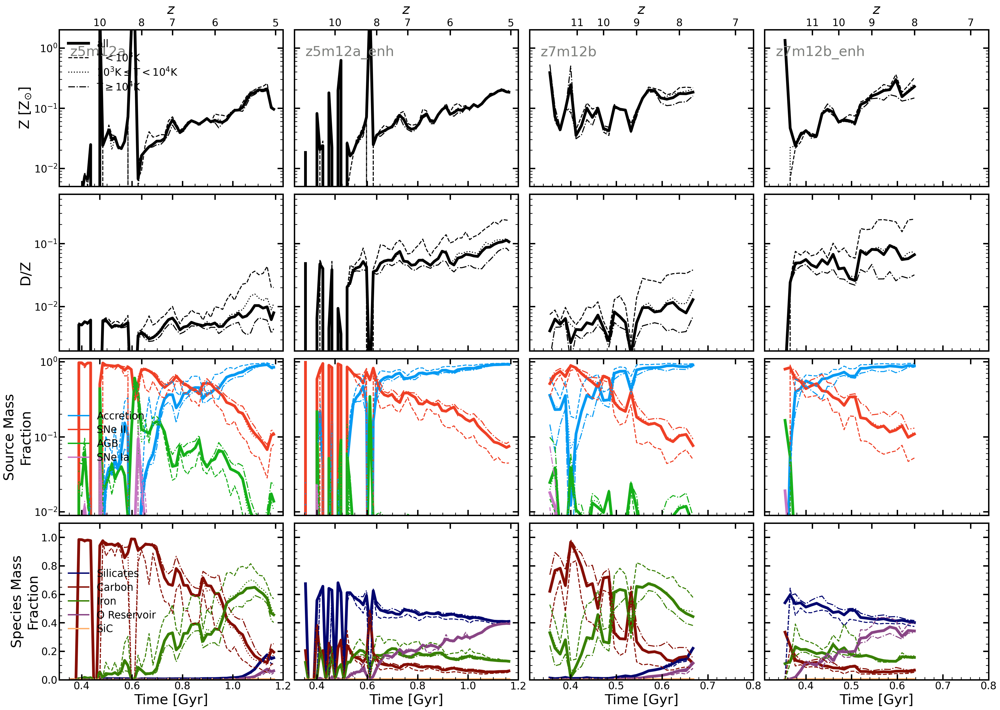

In [259]:
mask = z5m12a_z7m12b_mask
prefix='appendix_comparison2'

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-3,2E0],[2E-3,6E-1],[9E-3,1.1],[0,1.1]]
x_lims=[[0.31,1.2],[0.31,0.8]]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask][[0,2,1,3]]
sim_labels = short_names[mask][[0,2,1,3]]

# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lims[j//2], y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        for k,sample in enumerate(subsamples):
            # Check if parameter has subparameters
            if len(param_labels) == 0:
                data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
                fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                          linewidth=linewidths[k], zorder=-1)
            else:
                data_vals = []
                for sub_param in sub_y_props:
                    data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                data_vals = np.array(data_vals)
                for m in range(np.shape(data_vals)[0]):
                    # Ignore properties that are zero for the entire simulation and don't plot them
                    if not np.all(data_vals[m, :] == 0):
                        fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                  linewidth=linewidths[k], zorder=-1, label=param_labels[m])

            # Only need to label the subsamples in the first plot
            if axis_num == 0 and len(subsamples) > 1:
                fig.set_axis_legend(axis_num,ncol=1,loc='best')

            # If there are subparameters need to make their own legend but only for the first sim
            if len(param_labels) > 0 and j == 0:
                # param_labels = param_labels[:np.shape(data_vals)[1]]
                param_lines = []
                for k, label in enumerate(param_labels):
                    param_lines += [
                        mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=config.BASE_LINEWIDTH)]
                fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1)

fig.save(plot_dir+foutname)

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


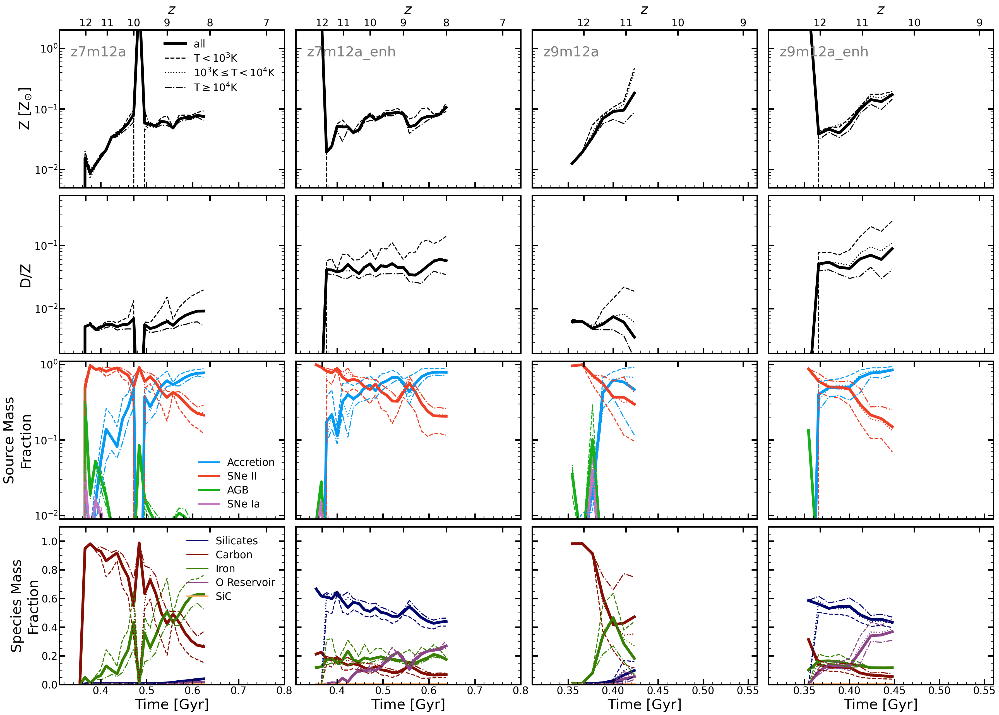

In [260]:
mask = z7m12a_z9m12a_mask
prefix='appendix_comparison3'

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-3,2E0],[2E-3,6E-1],[9E-3,1.1],[0,1.1]]
x_lims=[[0.31,0.8],[0.31,0.56]]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask][[0,2,1,3]]
sim_labels = short_names[mask][[0,2,1,3]]

# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lims[j//2], y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        for k,sample in enumerate(subsamples):
            # Check if parameter has subparameters
            if len(param_labels) == 0:
                data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
                fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                          linewidth=linewidths[k], zorder=-1)
            else:
                data_vals = []
                for sub_param in sub_y_props:
                    data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                data_vals = np.array(data_vals)
                for m in range(np.shape(data_vals)[0]):
                    # Ignore properties that are zero for the entire simulation and don't plot them
                    if not np.all(data_vals[m, :] == 0):
                        fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                  linewidth=linewidths[k], zorder=-1, label=param_labels[m])

            # Only need to label the subsamples in the first plot
            if axis_num == 0 and len(subsamples) > 1:
                fig.set_axis_legend(axis_num,ncol=1,loc='best')

            # If there are subparameters need to make their own legend but only for the first sim
            if len(param_labels) > 0 and j == 0:
                # param_labels = param_labels[:np.shape(data_vals)[1]]
                param_lines = []
                for k, label in enumerate(param_labels):
                    param_lines += [
                        mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=config.BASE_LINEWIDTH)]
                fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1)

fig.save(plot_dir+foutname)

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


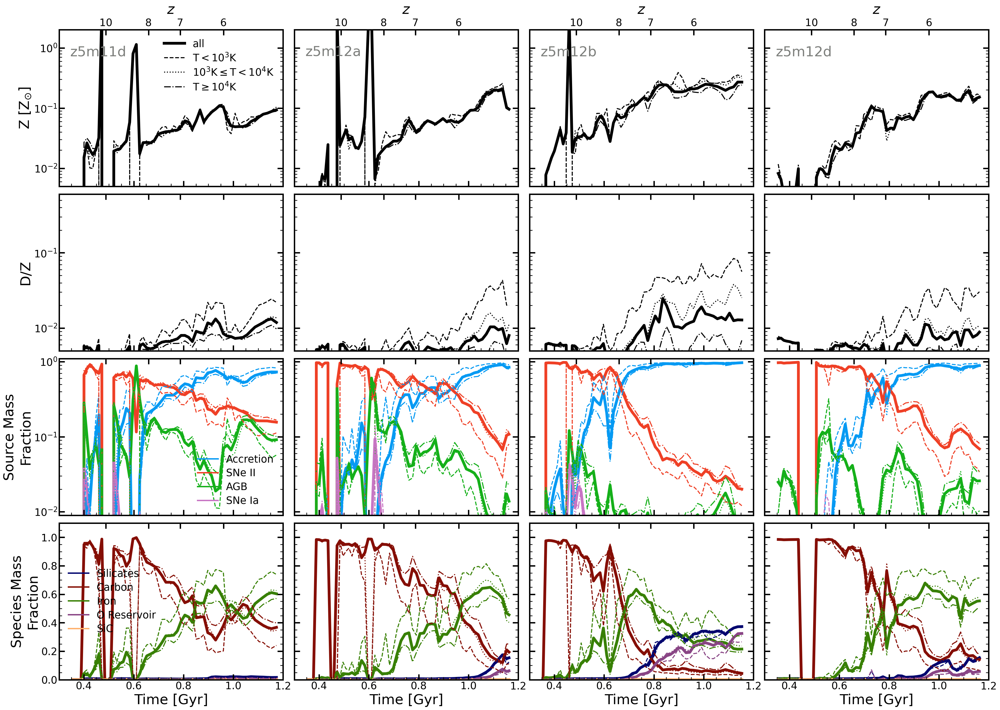

In [127]:
mask = z5fid_mask
prefix='z5_fiducial'

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-3,2E0],[5E-3,6E-1],[9E-3,1.1],[0,1.1]]
x_lim=[0.3,1.2]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
sim_labels = names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        for k,sample in enumerate(subsamples):
            # Check if parameter has subparameters
            if len(param_labels) == 0:
                data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
                fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                          linewidth=linewidths[k], zorder=-1)
            else:
                data_vals = []
                for sub_param in sub_y_props:
                    data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                data_vals = np.array(data_vals)
                for m in range(np.shape(data_vals)[0]):
                    # Ignore properties that are zero for the entire simulation and don't plot them
                    if not np.all(data_vals[m, :] == 0):
                        fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                  linewidth=linewidths[k], zorder=-1, label=param_labels[m])

            # Only need to label the subsamples in the first plot
            if axis_num == 0 and len(subsamples) > 1:
                fig.set_axis_legend(axis_num,ncol=1,loc='best')

            # If there are subparameters need to make their own legend but only for the first sim
            if len(param_labels) > 0 and j == 0:
                # param_labels = param_labels[:np.shape(data_vals)[1]]
                param_lines = []
                for k, label in enumerate(param_labels):
                    param_lines += [
                        mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=config.BASE_LINEWIDTH)]
                fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1)

fig.save(plot_dir+foutname)

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


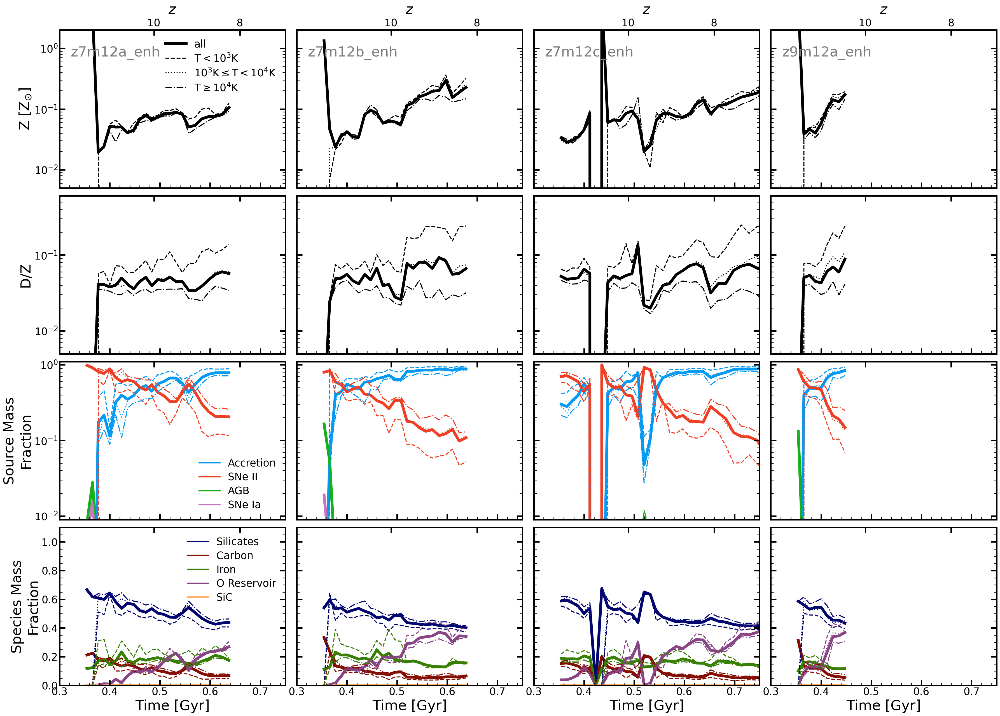

In [126]:
mask = z79enh_mask
prefix='z79_enhanced'

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-3,2E0],[5E-3,6E-1],[9E-3,1.1],[0,1.1]]
x_lim=[0.3,0.75]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
sim_labels = short_names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        for k,sample in enumerate(subsamples):
            # Check if parameter has subparameters
            if len(param_labels) == 0:
                data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
                fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                          linewidth=linewidths[k], zorder=-1)
            else:
                data_vals = []
                for sub_param in sub_y_props:
                    data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                data_vals = np.array(data_vals)
                for m in range(np.shape(data_vals)[0]):
                    # Ignore properties that are zero for the entire simulation and don't plot them
                    if not np.all(data_vals[m, :] == 0):
                        fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                  linewidth=linewidths[k], zorder=-1, label=param_labels[m])

            # Only need to label the subsamples in the first plot
            if axis_num == 0 and len(subsamples) > 1:
                fig.set_axis_legend(axis_num,ncol=1,loc='best')

            # If there are subparameters need to make their own legend but only for the first sim
            if len(param_labels) > 0 and j == 0:
                # param_labels = param_labels[:np.shape(data_vals)[1]]
                param_lines = []
                for k, label in enumerate(param_labels):
                    param_lines += [
                        mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=config.BASE_LINEWIDTH)]
                fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1)

fig.save(plot_dir+foutname)

source_frac z5m12a [0.35461059 0.36583948 0.37718486 0.38864483 0.40021822 0.41190389
 0.42370076 0.43560698 0.44762304 0.45974715 0.47197833 0.48381956
 0.49575853 0.50779284 0.51992329 0.5321475  0.54446631 0.5574711
 0.57057717 0.58378371 0.59708991 0.61049498 0.62399816 0.63759867
 0.65258475 0.66768543 0.6828998  0.69822782 0.71366684 0.72921686
 0.74487701 0.76064645 0.77549035 0.79042842 0.80545908 0.82058353
 0.83580022 0.85110851 0.86650684 0.88199651 0.89757596 0.91324461
 0.92900091 0.94449292 0.96006856 0.97572734 0.99146872 1.0072932
 1.02319829 1.03918449 1.05525129 1.07139823 1.08762482 1.10393059
 1.12031507 1.1367778  1.15331832 1.16294693]
[[0.00000000e+00 0.00000000e+00 0.00000000e+00 3.25524322e-04
  4.47890833e-04 1.00050159e-03 4.32940947e-03 1.53207296e-02
  0.00000000e+00 0.00000000e+00 1.09116254e-08 4.31943912e-03
  2.64347647e-02 3.81442622e-02 3.22635760e-02 4.92347985e-02
  3.68400762e-02 6.78125389e-02 1.52895001e-01 1.06808652e-01
  8.89881142e-06 3.05650

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


source_frac z5m12a_0.9sd [0.35461059 0.36583948 0.37718486 0.38864483 0.40021822 0.41190389
 0.42370076 0.43560698 0.44762304 0.45974715 0.47197833 0.48381956
 0.49575853 0.50779284 0.51992329 0.5321475  0.54446631 0.5574711
 0.57057717 0.58378371 0.59708991 0.61049498 0.62399816 0.63759867
 0.65258475 0.66768543 0.6828998  0.69822782 0.71366684 0.72921686
 0.74487701 0.76064645 0.77549035 0.79042842 0.80545908 0.82058353
 0.83580022 0.85110851 0.86650684 0.88199651 0.89757596 0.91324461
 0.92900091 0.94449292 0.96006856 0.97572734 0.99146872 1.0072932
 1.02319829 1.03918449 1.05525129 1.07139823 1.08762482 1.10393059
 1.12031507 1.1367778  1.15331832 1.16294693]
[[1.88682812e-01 1.95396333e-01 3.11587520e-01 2.50349991e-01
  2.64269316e-01 5.78411833e-03 2.40569971e-05 2.03663647e-01
  3.63460841e-01 3.28203027e-01 1.75114492e-01 3.23114293e-01
  2.73194952e-01 3.44860373e-01 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.47584347e-01 2.64646424e-01 2.82234869e-01
  2.73565428e-01 2

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:243: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(),**kwargs)


spec_frac z5m12a_0.9sd [0.35461059 0.36583948 0.37718486 0.38864483 0.40021822 0.41190389
 0.42370076 0.43560698 0.44762304 0.45974715 0.47197833 0.48381956
 0.49575853 0.50779284 0.51992329 0.5321475  0.54446631 0.5574711
 0.57057717 0.58378371 0.59708991 0.61049498 0.62399816 0.63759867
 0.65258475 0.66768543 0.6828998  0.69822782 0.71366684 0.72921686
 0.74487701 0.76064645 0.77549035 0.79042842 0.80545908 0.82058353
 0.83580022 0.85110851 0.86650684 0.88199651 0.89757596 0.91324461
 0.92900091 0.94449292 0.96006856 0.97572734 0.99146872 1.0072932
 1.02319829 1.03918449 1.05525129 1.07139823 1.08762482 1.10393059
 1.12031507 1.1367778  1.15331832 1.16294693]
[[5.52302737e-01 5.50306033e-01 4.73153610e-01 5.12755584e-01
  5.01842094e-01 6.64830187e-01 6.56686942e-01 5.40522882e-01
  4.37766288e-01 4.61986964e-01 5.61391806e-01 4.63073929e-01
  4.95688415e-01 4.56798695e-01 0.00000000e+00 0.00000000e+00
  0.00000000e+00 5.22467768e-01 5.15703611e-01 5.06336266e-01
  5.15002320e-01 5.3

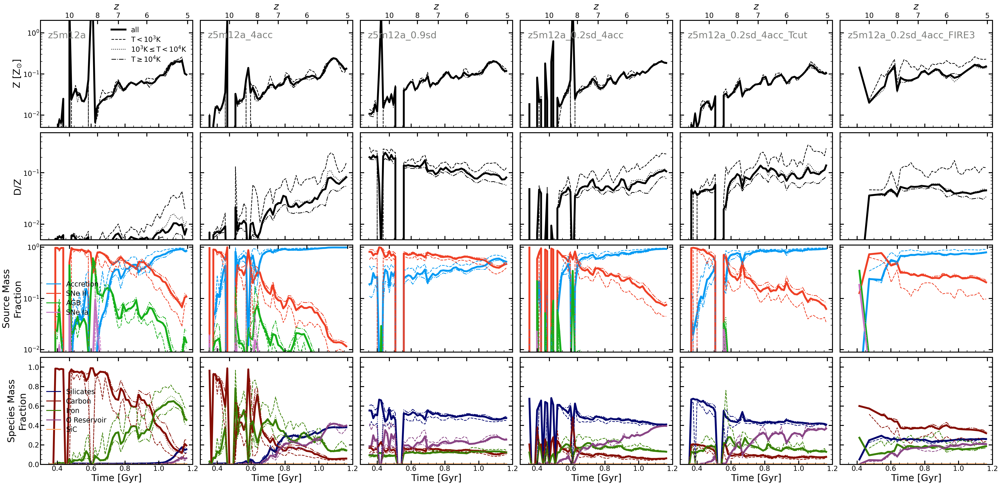

In [237]:
mask = z5m12a_mask
prefix='appendix_z5m12a'

foutname = prefix+'_'+str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-3,2E0],[5E-3,6E-1],[9E-3,1.1],[0,1.1]]
x_lim=[0.3,1.2]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
sim_labels = names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsample = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsample), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        
        for k,sample in enumerate(subsample):
            # Check if parameter has subparameters
            if len(param_labels) == 0:
                data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
                fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                          linewidth=linewidths[k], zorder=-1)
            else:
                data_vals = []
                for sub_param in sub_y_props:
                    data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                data_vals = np.array(data_vals)
                print(y_prop,sim_labels[j],time_data)
                print(data_vals)
                for m in range(np.shape(data_vals)[0]):
                    # Ignore properties that are zero for the entire simulation and don't plot them
                    if not np.all(data_vals[m, :] == 0):
                        fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                  linewidth=linewidths[k], zorder=-1, label=param_labels[m])

            # Only need to label the subsamples in the first plot
            if axis_num == 0 and len(subsamples) > 1:
                fig.set_axis_legend(axis_num,ncol=1,loc='upper right')

            # If there are subparameters need to make their own legend but only for the first sim
            if len(param_labels) > 0 and j == 0:
                # param_labels = param_labels[:np.shape(data_vals)[1]]
                param_lines = []
                for k, label in enumerate(param_labels):
                    param_lines += [
                        mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=config.BASE_LINEWIDTH)]
                fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1)

fig.save(plot_dir+foutname)

## Multi-Snap Evolution Plots

Makes various plots of galactic dust properties evolving through redshift.

In [26]:
# Load primary halos for each snapshot at simulation end

halos = []
rvir_frac=0.2
id=-1

# Corresponds to z=5,6,7,8,9,10 for FIRE 2
FIRE2_base_snap_nums = np.array([67,52,41,33,26,20])
FIRE3_base_snap_nums = np.array([42,32,24,18,13,12])
sims=[]

sim_snap_nums = []

for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    if FIRE_ver[i] == 2:
        snap_nums = FIRE2_base_snap_nums[FIRE2_base_snap_nums<=final_snaps[i]]
    else:
        snap_nums = FIRE3_base_snap_nums[FIRE3_base_snap_nums<=final_snaps[i]]
    # If last sim snap is not at a int value of redshift tack it onto the list
    if len(snap_nums)==0 or final_snaps[i] > snap_nums[0]:
        snap_nums = np.append([final_snaps[i]],snap_nums)
    print(snap_dir)
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)
    sim_snap_nums+=[snap_nums]
    sims+=[buff]

sims = np.array(sims)
# Need to set to this specific numpy array to have inhomogenous 2D numpy arrays
sim_snap_nums = np.array(sim_snap_nums, dtype=object)


/N/scratch/cchoban/HiZ_dust/z5m11d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z7m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z7m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing 

### Dust-to-stellar mass relation with observations from ALMA

Fudamoto


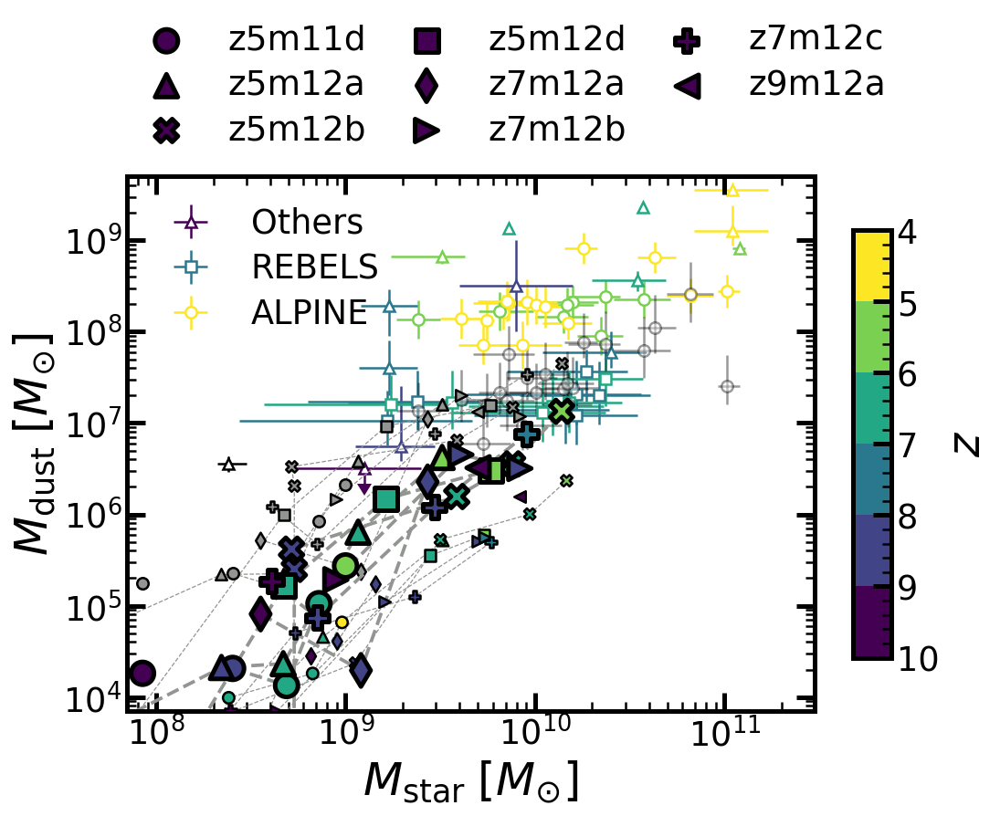

In [8]:
prefix = 'comparison'
mask = fid_and_enh_mask

foutname=prefix+'_'+str(rvir_frac)+'Rvir_Mstar_vs_Mdust.pdf'
x_props = ['M_star']
y_props=['M_dust']
x_lims = [[7E7,3E11]]
y_lims = [[7E3,5E9]]

simulations = sims[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria='all'
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(simulations), style=style)

fig = Figure(len(x_props),ncols=1,sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        # Have to plot these one by one since errorbar only takes one color at a time
        for k in range(len(redshifts)):
            alpha=1
            if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
            elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
            elif source[k] == 'Sommovigo+22': fmt='o';source_label=None;alpha=0.4
            else: fmt='^';source_label='Others'
            if source[k] == 'Fudamoto+23':
                print('Fudamoto')
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                   ms=config.SMALL_MARKERSIZE**.5, mfc='xkcd:white', zorder=0, label=source_label)
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=np.power(10,np.log10(yprop_data[k])-0.5),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0,
                                   ms=0, mfc='xkcd:white', zorder=-1, label=None, uplims=True,capsize=5)
            else:
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                   ms=config.SMALL_MARKERSIZE**.5, mfc='xkcd:white', zorder=0, label=source_label,alpha=alpha)
    if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    half_len = len(simulations)//2
    for j, sim_buff in enumerate(simulations):
        if j < half_len:
            label = None
            marker=config.MARKER_STYLES[j]
            alpha=1
            s=config.SMALL_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[4]
            linewidth=config.LINE_WIDTHS[5]
        else:
            label=labels[j-half_len]
            marker=config.MARKER_STYLES[j-half_len]
            alpha=1
            s=config.LARGE_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[2]
            linewidth=config.LINE_WIDTHS[3]

        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j])
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=marker, c=times, cmap=cmap, norm=norm,
                     s=s, edgecolors=config.BASE_COLOR, linewidths=m_linewidth, zorder=3, alpha=alpha)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=linewidth, zorder=2, alpha=alpha)

        # Also include upper bound with D/Z=0.6
        if j >= half_len:
            label=None
            alpha=1
            s=config.SMALL_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[4]
            linewidth=config.LINE_WIDTHS[5]
    
            y_vals = sim_buff.get_data('M_metals', snap_nums = sim_snaps[j])*0.6
            fig.plot_scatter_data(i, x_vals, y_vals, marker=marker, c='xkcd:grey',
                         s=s, edgecolors=config.BASE_COLOR, linewidths=m_linewidth, zorder=2, alpha=alpha)
            if connect_points:
                fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=linewidth, zorder=1, alpha=alpha)
    

fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

O/H_gas is not in the specified date frame


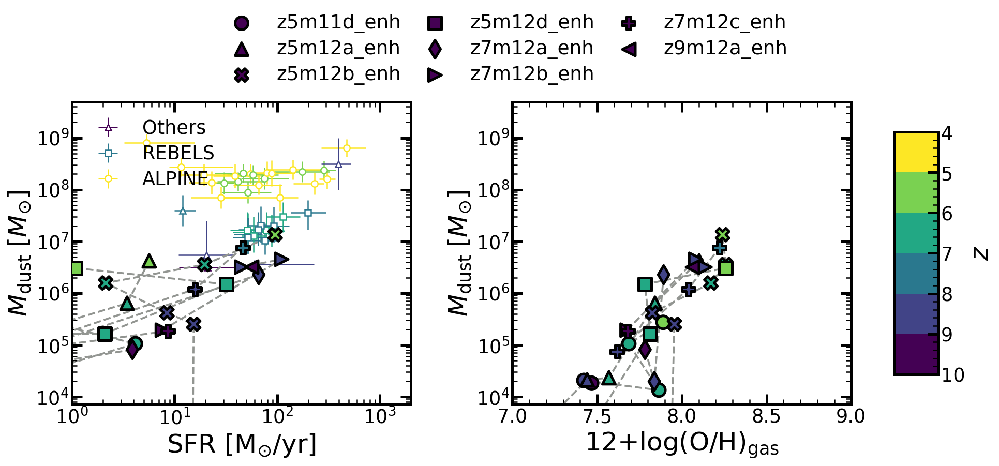

In [175]:
prefix = 'enhanced'
mask = enhanced_mask

foutname=prefix+'_Mdust_vs_SFR_Z.pdf'
x_props = ['sfr','O/H_gas']
y_props=['M_dust','M_dust']
x_lims = [[1,2E3],[7,9]]
y_lims = [[7E3,5E9],[7E3,5E9]]

simulations = sims[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria=['all','ionized']
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(simulations), style=style)

fig = Figure(len(x_props),ncols=2,orientation='horizontal')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        if xprop_data is not None and yprop_data is not None:
            # Have to plot these one by one since errorbar only takes one color at a time
            for k in range(len(redshifts)):
                if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
                elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
                else: fmt='^';source_label='Others'
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                       ms=config.SMALL_MARKERSIZE**.5, mfc='xkcd:white', zorder=2, label=source_label)
        if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    for j, sim_buff in enumerate(simulations):
        label = labels[j]
        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j],subsample=x_crit)
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=config.MARKER_STYLES[j], c=times, cmap=cmap, norm = norm,
                     s=config.LARGE_MARKERSIZE, edgecolors=config.BASE_COLOR, linewidths=config.LINE_WIDTHS[2], zorder=3)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=config.LINE_WIDTHS[3], zorder=2)

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

Z is not in the specified date frame
O/H_gas is not in the specified date frame
Z is not in the specified date frame
O/H_gas is not in the specified date frame
Z is not in the specified date frame
O/H is not in the specified date frame


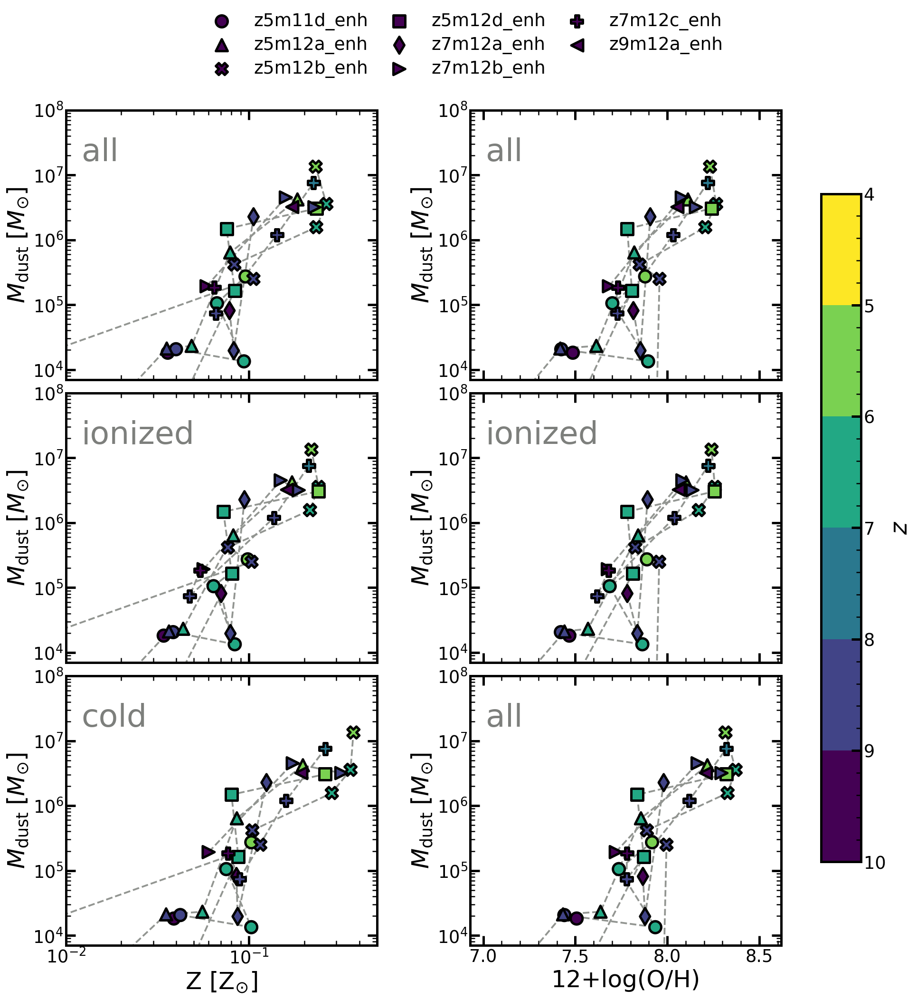

In [27]:
prefix = 'enhanced'
mask = enhanced_mask

foutname=prefix+'_Mdust_vs_Z_definitions.pdf'
x_props = ['Z','O/H_gas','Z','O/H_gas','Z','O/H']
y_props=['M_dust']*len(x_props)
x_lims = [[1E-2,0.5],[6.93,8.62],[1E-2,0.5],[6.93,8.62],[1E-2,0.5],[6.93,8.62]]
y_lims = [[7E3,1E8]]*len(x_props)

simulations = sims[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria=['all','all','ionized','ionized','cold','all']
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(simulations), style=style)

fig = Figure(len(x_props),ncols=2,orientation='horizontal',sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        if xprop_data is not None and yprop_data is not None:
            # Have to plot these one by one since errorbar only takes one color at a time
            for k in range(len(redshifts)):
                if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
                elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
                else: fmt='^';source_label='Others'
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                       ms=config.SMALL_MARKERSIZE**.5, mfc='xkcd:white', zorder=2, label=source_label)
        if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    for j, sim_buff in enumerate(simulations):
        label = labels[j]
        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j],subsample=x_crit)
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=config.MARKER_STYLES[j], c=times, cmap=cmap, norm = norm,
                     s=config.LARGE_MARKERSIZE, edgecolors=config.BASE_COLOR, linewidths=config.LINE_WIDTHS[2], zorder=3)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=config.LINE_WIDTHS[3], zorder=2)
            
    fig.add_text(i, .05, .9, x_crit, color='xkcd:medium grey', fontsize=config.EXTRA_LARGE_FONT, ha='left',
                    va='top', zorder=1)

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

all
O/H_gas is not in the specified date frame
cold
O/H_gas is not in the specified date frame
D/Z is not in the specified date frame


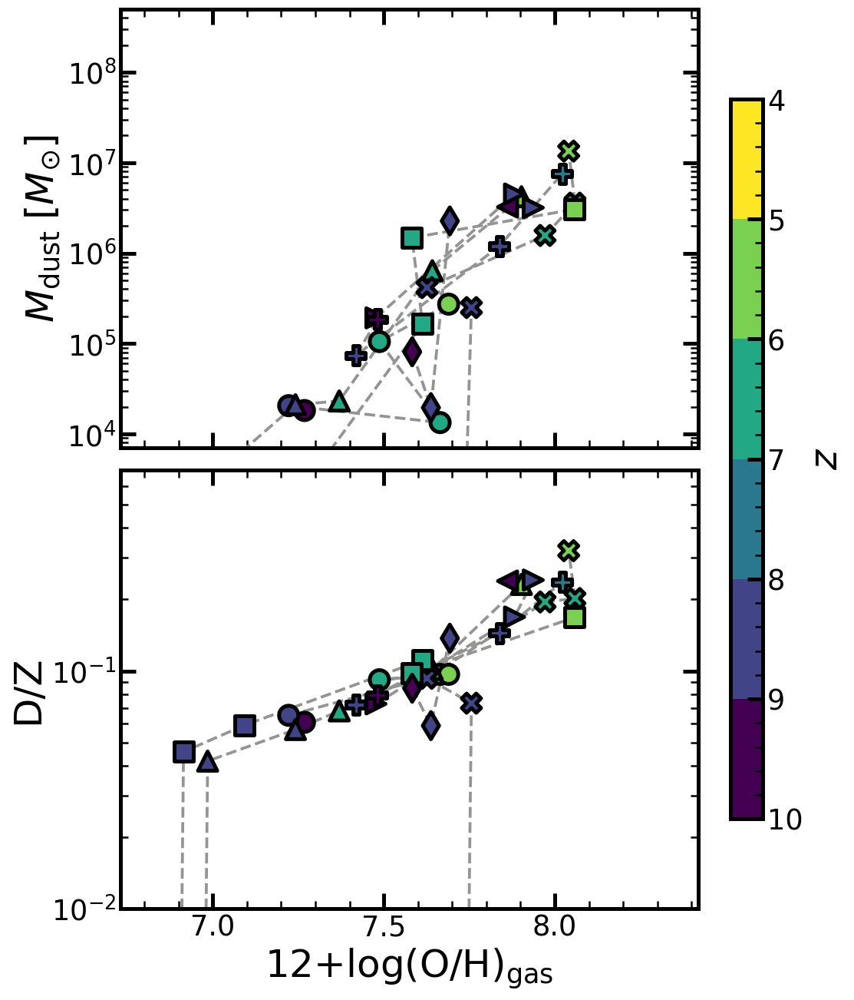

In [269]:
prefix = 'enhanced'
mask = enhanced_mask

foutname=prefix+'_Mdust_scaling_relations.pdf'
x_props = ['O/H_gas','O/H_gas']
y_props=['M_dust','D/Z']
x_lims = [[6.73,8.42],[6.73,8.42]]
y_lims = [[7E3,5E8],[0.01,0.7]]

simulations = sims[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria=['ionized','ionized',]
y_criteria=['all','cold']
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(simulations), style=style)

fig = Figure(len(x_props),ncols=1,sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria
    print(y_crit)

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        if xprop_data is not None and yprop_data is not None:
            # Have to plot these one by one since errorbar only takes one color at a time
            for k in range(len(redshifts)):
                if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
                elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
                else: fmt='^';source_label='Others'
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                       ms=config.SMALL_MARKERSIZE**.5, mfc='xkcd:white', zorder=2, label=source_label)
        if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    for j, sim_buff in enumerate(simulations):
        label = labels[j]
        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j],subsample=y_crit)
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j],subsample=x_crit)
        # Need to offset O/H between d
        if 'O/H' in x_prop:
            x_vals-=0.2
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=config.MARKER_STYLES[j], c=times, cmap=cmap, norm = norm,
                     s=config.LARGE_MARKERSIZE, edgecolors=config.BASE_COLOR, linewidths=config.LINE_WIDTHS[2], zorder=3)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=config.LINE_WIDTHS[3], zorder=2)

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
#fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

#### Plot $M_{dust}$ vs $M_{star}$ Relation

This requires loading in data from both the central part of the galaxy and all of the galactic halo

In [11]:
# Load primary halos for each snapshot at simulation end
# Corresponds to z=5,6,7,8,9,10 for FIRE 2
FIRE2_base_snap_nums = np.array([67,52,41,33,26,20])
FIRE3_base_snap_nums = np.array([42,32,24,18,13,12])


rvir_frac=1
sims_Rvir=[]
sim_snap_nums = []

for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    if FIRE_ver[i] == 2:
        snap_nums = FIRE2_base_snap_nums[FIRE2_base_snap_nums<=final_snaps[i]]
    else:
        snap_nums = FIRE3_base_snap_nums[FIRE3_base_snap_nums<=final_snaps[i]]
    # If last sim snap is not at a int value of redshift tack it onto the list
    if len(snap_nums)==0 or final_snaps[i] > snap_nums[0]:
        snap_nums = np.append([final_snaps[i]],snap_nums)
    print(snap_dir)
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)
    sim_snap_nums+=[snap_nums]
    sims_Rvir+=[buff]

sims_Rvir = np.array(sims_Rvir)

rvir_frac=0.2
sims_lowRvir=[]
sim_snap_nums = []

for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    if FIRE_ver[i] == 2:
        snap_nums = FIRE2_base_snap_nums[FIRE2_base_snap_nums<=final_snaps[i]]
    else:
        snap_nums = FIRE3_base_snap_nums[FIRE3_base_snap_nums<=final_snaps[i]]
    # If last sim snap is not at a int value of redshift tack it onto the list
    if len(snap_nums)==0 or final_snaps[i] > snap_nums[0]:
        snap_nums = np.append([final_snaps[i]],snap_nums)
    print(snap_dir)
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)
    sim_snap_nums+=[snap_nums]
    sims_lowRvir+=[buff]

sims_lowRvir = np.array(sims_lowRvir)

# Need to set to this specific numpy array to have inhomogenous 2D numpy arrays
sim_snap_nums = np.array(sim_snap_nums, dtype=object)


/N/scratch/cchoban/HiZ_dust/z5m11d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z7m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z7m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing 

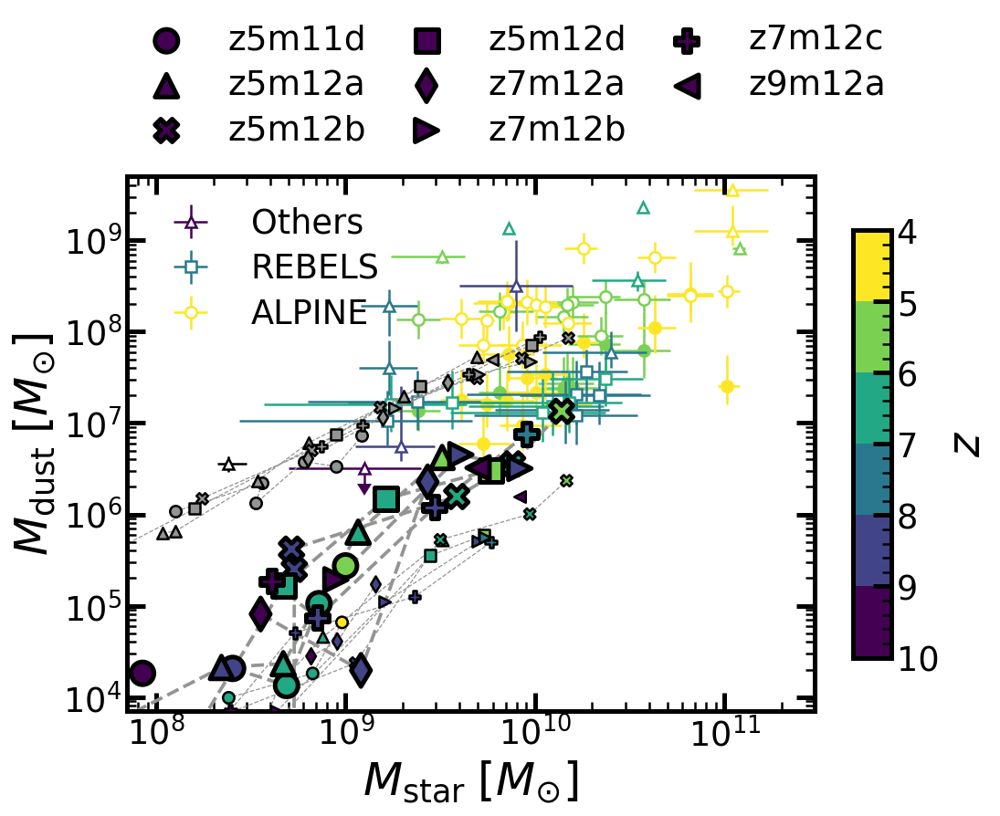

In [25]:
prefix = 'comparison'
mask = fid_and_enh_mask

foutname=prefix+'_'+str(rvir_frac)+'Rvir_Mstar_vs_Mdust_w_1Rvir_upperbound.pdf'
x_props = ['M_star']
y_props=['M_dust']
x_lims = [[7E7,3E11]]
y_lims = [[7E3,5E9]]

lowRvir_simulations = sims_lowRvir[mask]
Rvir_simulations = sims_Rvir[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria='all'
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(lowRvir_simulations), style=style)

fig = Figure(len(x_props),ncols=1,sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        # Have to plot these one by one since errorbar only takes one color at a time
        for k in range(len(redshifts)):
            alpha=1;zorder=0;mfc='xkcd:white'
            if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
            elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
            elif source[k] == 'Sommovigo+22': fmt='o';source_label=None;alpha=1;zorder=-1;mfc=cmap(norm(redshifts[k]))
            else: fmt='^';source_label='Others'
            if source[k] == 'Fudamoto+23':
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                   ms=config.SMALL_MARKERSIZE**.5, mfc=mfc, zorder=zorder, label=source_label)
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=np.power(10,np.log10(yprop_data[k])-0.5),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0,
                                   ms=0, mfc=mfc, zorder=zorder-1, label=None, uplims=True,capsize=5)
            else:
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                   ms=config.SMALL_MARKERSIZE**.5, mfc=mfc, zorder=zorder, label=source_label,alpha=alpha)
    if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    half_len - len(lowRvir_simulations)//2
    for j, sim_buff in enumerate(lowRvir_simulations):
        if j < half_len:
            label = None
            marker=config.MARKER_STYLES[j]
            alpha=1
            s=config.SMALL_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[4]
            linewidth=config.LINE_WIDTHS[5]
        else:
            label=labels[j-half_len]
            marker=config.MARKER_STYLES[j-half_len]
            alpha=1
            s=config.LARGE_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[2]
            linewidth=config.LINE_WIDTHS[3]

        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j])
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=marker, c=times, cmap=cmap, norm=norm,
                     s=s, edgecolors=config.BASE_COLOR, linewidths=m_linewidth, zorder=3, alpha=alpha)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=linewidth, zorder=2, alpha=alpha)

        # Also include upper bound with D/Z=0.6
        if j >= half_len:
            sim_buff = Rvir_simulations[j]
            label=None
            alpha=1
            s=config.SMALL_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[4]
            linewidth=config.LINE_WIDTHS[5]

            times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
            y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
            x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j])
            y_vals = sim_buff.get_data('M_metals', snap_nums = sim_snaps[j])*0.6
            fig.plot_scatter_data(i, x_vals, y_vals, marker=marker, c='xkcd:grey',
                         s=s, edgecolors=config.BASE_COLOR, linewidths=m_linewidth, zorder=2, alpha=alpha)
            if connect_points:
                fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=linewidth, zorder=1, alpha=alpha)
    

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

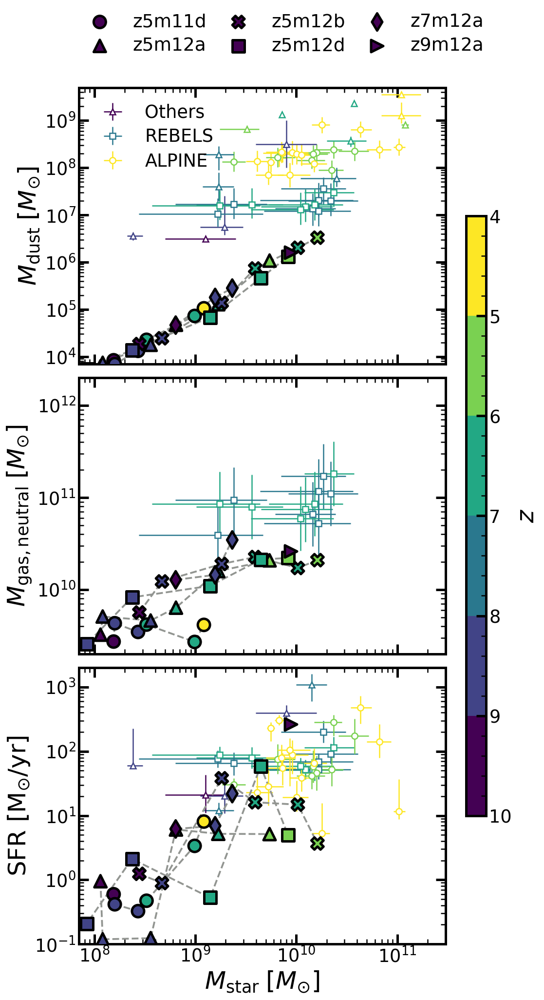

In [10]:
prefix = 'fiducial'
mask = fiducial_mask

foutname=prefix+'_Mstar_vs_Mdust_SFR_Mgas.pdf'
x_props = ['M_star','M_star','M_star']
y_props=['M_dust','M_gas_neutral','sfr']
x_lims = [[7E7,3E11],[7E7,3E11],[7E7,3E11]]
y_lims = [[7E3,5E9],[2E9,2E12],[.1,2E3]]

simulations = sims[mask]
labels = names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria='all'
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(simulations), style=style)

fig = Figure(len(x_props),ncols=1,sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        # Have to plot these one by one since errorbar only takes one color at a time
        for k in range(len(redshifts)):
            if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
            elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
            else: fmt='^';source_label='Others'
            fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                   ms=config.SMALL_MARKERSIZE**.5, mfc='xkcd:white', zorder=2, label=source_label)
    if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    for j, sim_buff in enumerate(simulations):
        label = labels[j]
        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j])
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=config.MARKER_STYLES[j], c=times, cmap=cmap, norm = norm,
                     s=config.LARGE_MARKERSIZE, edgecolors=config.BASE_COLOR, linewidths=config.LINE_WIDTHS[2], zorder=3)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=config.LINE_WIDTHS[3], zorder=2)

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

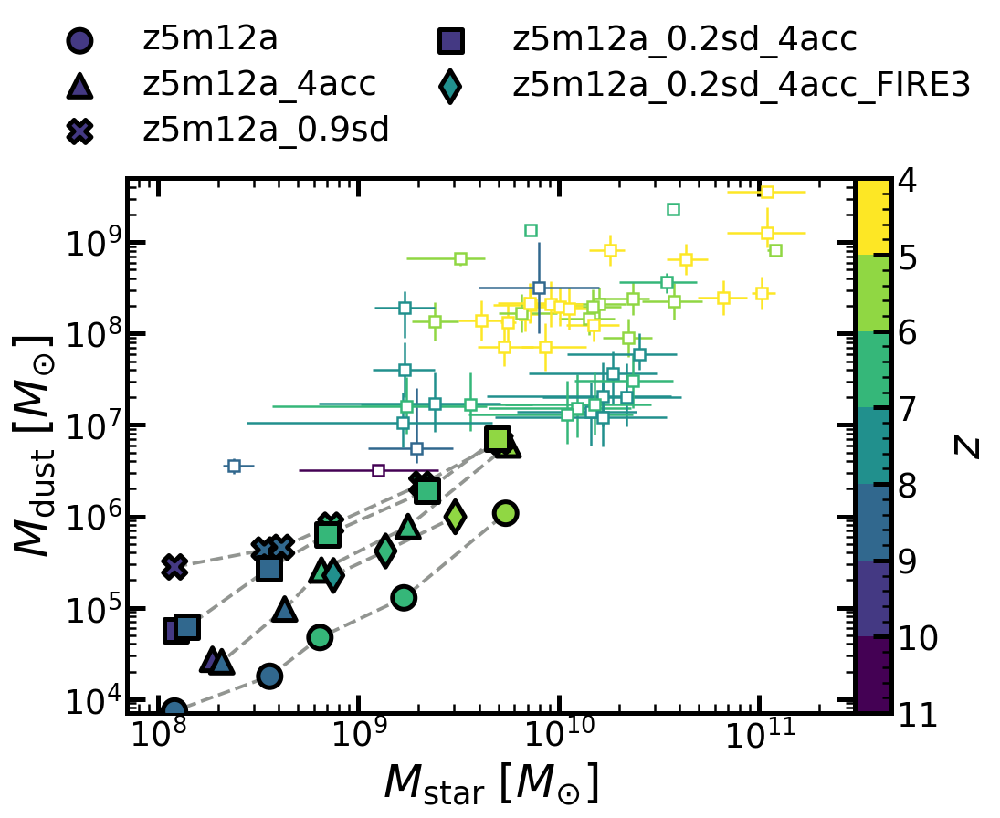

In [26]:
foutname=plot_dir+'z5m12a_Mstar_vs_Mdust.pdf'
x_props = ['M_star']
y_props=['M_dust']
x_lims = [[7E7,3E11]]
y_lims = [[7E3,5E9]]

simulations = sims[z5m12a_mask]
labels = names[z5m12a_mask]
x_criteria='all'
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,11]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(simulations), style=style)

fig = Figure(len(x_props),ncols=1,sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        # Have to plot these one by one since errorbar only takes one color at a time
        for k in range(len(redshifts)):
            fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                   fmt='s', c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                   ms=config.SMALL_MARKERSIZE**.5, mfc='xkcd:white', zorder=3)

    for j, sim_buff in enumerate(simulations):
        label = labels[j]
        times = sim_buff.get_data('redshift', snap_nums = sim_snap_nums[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snap_nums[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snap_nums[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snap_nums[j])
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=config.MARKER_STYLES[j], c=times, cmap=cmap, norm = norm,
                     s=config.LARGE_MARKERSIZE, edgecolors=config.BASE_COLOR, linewidths=config.LINE_WIDTHS[2], zorder=3)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=config.LINE_WIDTHS[3], zorder=2)

fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=2, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(foutname)

## Comparison with Original Runs from Ma+19

In [36]:
# Main directory
orig_dirc = '/N/scratch/cchoban/orig_HiZ/'
# Names of simulation directories
orig_names = np.array(['z5m11d','z5m12a','z5m12b','z5m12d'])
orig_labels = np.array(['old z5m11d','old z5m12a','old z5m12b','old z5m12d'])

# Main sim directories and their snap and halo directories
orig_main_dirs = [orig_dirc+name+'/' for name in orig_names]
orig_snap_dirs = [orig_dirc+name+'/output/' for name in orig_names]
# Use new AHF halos for now
orig_hdirs = [orig_dirc+name+'/halo/AHF/' for name in orig_names]
# We only look at the main halos
orig_halo_histories = [main_dirc+name+'/AHF_data/AHF_output/halo_0000000.dat' for name in orig_names]

orig_final_snaps=final_snaps[z5_mask]

In [38]:
rvir_frac=0.2
id=-1

# Corresponds to z=5,6,7,8,9,10
base_snap_nums = np.array([67,52,41,33,26,20])
orig_sims=[]

for i in range(len(orig_names)):
    snap_dir = orig_snap_dirs[i]; hdir = orig_hdirs[i];final_snap=orig_final_snaps[i];halo_file=orig_halo_histories[i]
    snap_nums = base_snap_nums[base_snap_nums<=orig_final_snaps[i]]
    # If last sim snap is not at a int value of redshift tack it onto the list
    if  len(snap_nums)==0 or orig_final_snaps[i] > snap_nums[0]:
        snap_nums = np.append([orig_final_snaps[i]],snap_nums)
    print(snap_dir)
    snap_nums = list(range(11,orig_final_snaps[i]+1))
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file,base_FIRE=True)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)

    orig_sims+=[buff]
orig_sims=np.array(orig_sims)

/N/scratch/cchoban/orig_HiZ/z5m11d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/orig_HiZ/z5m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/orig_HiZ/z5m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/orig_HiZ/z5m12d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....


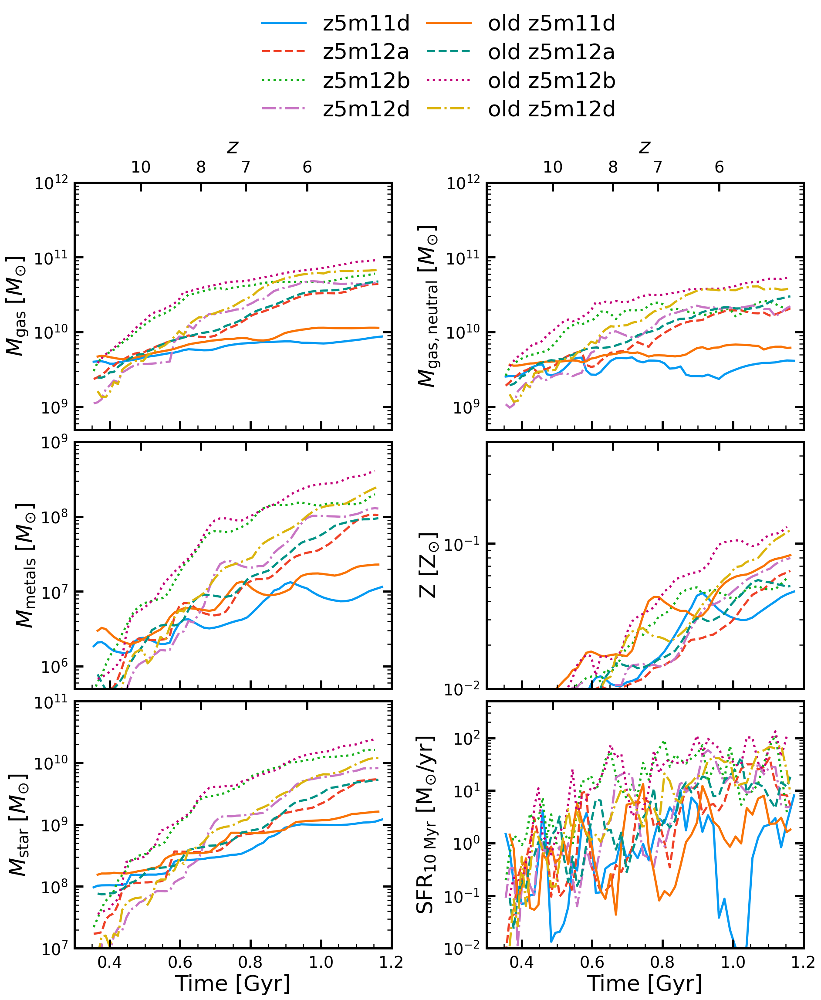

In [42]:
foutname = 'FIREversion_galaxy_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_gas','M_gas_neutral','M_metals','Z','M_star','sfr_10Myr']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E8,1E12],[5E8,1E12],[5E5,1E9],[1E-2,0.5],[1E7,1E11],[1E-2,5E2]]
x_lim=[0.3,1.2]
y_logs=[True]*(len(params))

# The precompile data objects which house all of the time evolution data
data_objs = np.append(sims[z5_mask],orig_sims)
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
gas_sample = 'all'
star_sample='all'
subsample = 'all'
# Labels you to give to the data objects
labels = np.append(names[z5_mask],orig_labels)
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex=True, orientation='vertical',ncols=2)

for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=2)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


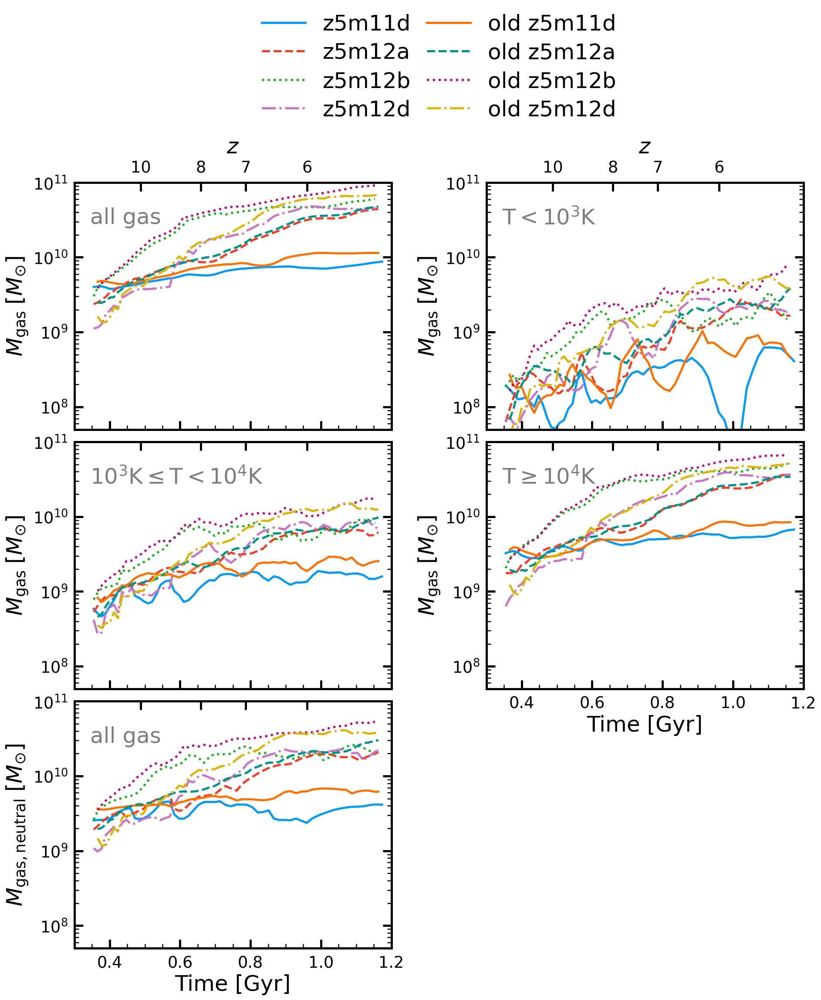

In [41]:
foutname = 'FIREversion_galaxy_ISMphase_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_gas','M_gas','M_gas','M_gas','M_gas_neutral']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E7,1E11]]*len(params)
x_lim=[0.3,1.2]
y_logs=[True]*(len(params))

# The precompile data objects which house all of the time evolution data
data_objs = np.append(sims[z5_mask],orig_sims)
# The statistic you want to use when plotting quantities that could be averaged
stat = 'total'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsample = ['all','cold','warm','hot','all']
subsample_labels = ['all gas',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K','all gas']
# Labels you to give to the data objects
labels = np.append(names[z5_mask],orig_labels)
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex=True, orientation='vertical',ncols=2)

for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    fig.add_text(i, .05, .9, subsample_labels[i], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                va='top', zorder=1)

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=2)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)
